# Problem Definition & Planning

In [1]:
!pip install pandas numpy matplotlib seaborn scikit-learn scipy imblearn


   ------------- -------------------------- 1/3 [imbalanced-learn]
   ------------- -------------------------- 1/3 [imbalanced-learn]
   ------------- -------------------------- 1/3 [imbalanced-learn]
   ------------- -------------------------- 1/3 [imbalanced-learn]
   -------------------------- ------------- 2/3 [imblearn]
   ---------------------------------------- 3/3 [imblearn]



# Data Collection & Acquisition

In [2]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import (StandardScaler, MinMaxScaler, RobustScaler, 
                                   LabelEncoder, OneHotEncoder, OrdinalEncoder)
from sklearn.feature_selection import (SelectKBest, chi2, f_classif, f_regression, 
                                       RFE, SelectFromModel, VarianceThreshold, mutual_info_regression)
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score, KFold
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.linear_model import Lasso, Ridge, LinearRegression
from imblearn.over_sampling import SMOTE, ADASYN
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', None)

In [3]:
data = pd.read_csv("Data/data.csv")

In [4]:
data

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,RL,62.0,7917,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1999,2000,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,953,953,GasA,Ex,Y,SBrkr,953,694,0,1647,0,0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1999.0,RFn,2,460,TA,TA,Y,0,40,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,175000
1456,1457,20,RL,85.0,13175,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1978,1988,Gable,CompShg,Plywood,Plywood,Stone,119.0,TA,TA,CBlock,Gd,TA,No,ALQ,790,Rec,163,589,1542,GasA,TA,Y,SBrkr,2073,0,0,2073,1,0,2,0,3,1,TA,7,Min1,2,TA,Attchd,1978.0,Unf,2,500,TA,TA,Y,349,0,0,0,0,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal,210000
1457,1458,70,RL,66.0,9042,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,9,1941,2006,Gable,CompShg,CemntBd,CmentBd,NaN,0.0,Ex,Gd,Stone,TA,Gd,No,GLQ,275,Unf,0,877,1152,GasA,Ex,Y,SBrkr,1188,1152,0,2340,0,0,2,0,4,1,Gd,9,Typ,2,Gd,Attchd,1941.0,RFn,1,252,TA,TA,Y,0,60,0,0,0,0,NaN,GdPrv,Shed,2500,5,2010,WD,Normal,266500
1458,1459,20,RL,68.0,9717,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1950,1996,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,TA,TA,Mn,GLQ,49,Rec,1029,0,1078,GasA,Gd,

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [6]:
data.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [7]:
data.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

# Exploratory Data Analysis (EDA)

In [9]:
# Set style
sns.set_style("whitegrid")
plt.rcParams['figure.figsize'] = (12, 8)

In [10]:
# Separate numeric and categorical columns
numeric_cols = data.select_dtypes(include=[np.number]).columns.tolist()
if 'Id' in numeric_cols:
    numeric_cols.remove('Id')
    
categorical_cols = data.select_dtypes(include=['object']).columns.tolist()

In [11]:
print(f"Total numeric columns: {len(numeric_cols)}")
print(f"Total categorical columns: {len(categorical_cols)}")

Total numeric columns: 37
Total categorical columns: 43


## DISTRIBUTION PLOTS FOR ALL NUMERIC COLUMNS

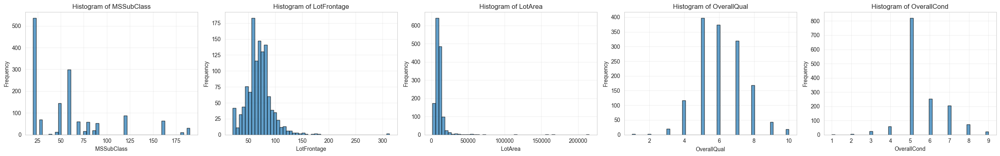

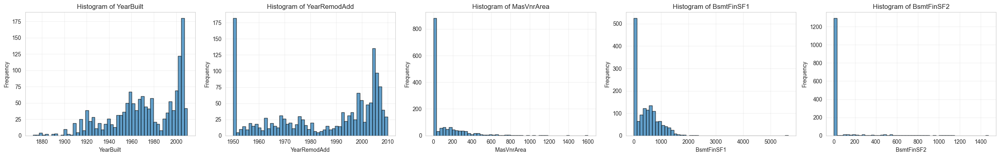

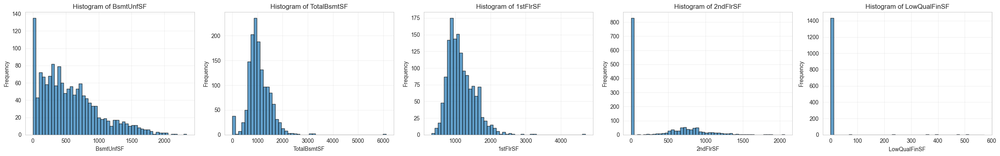

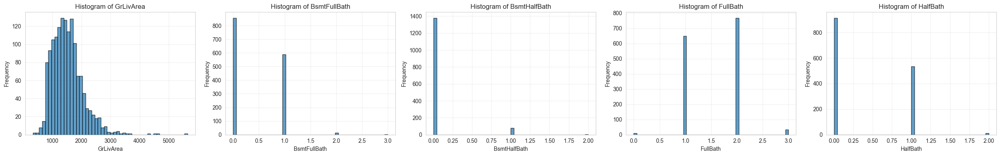

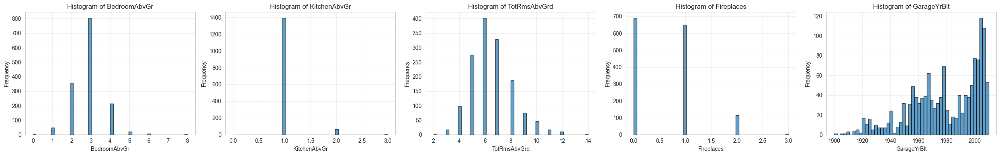

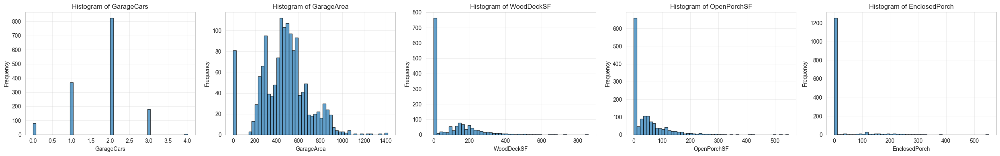

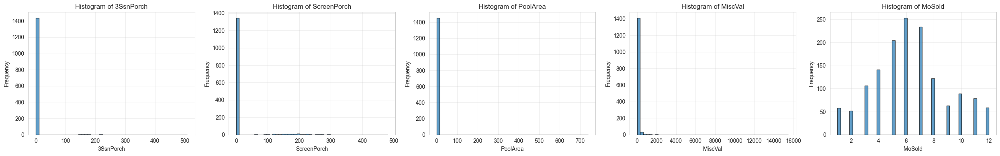

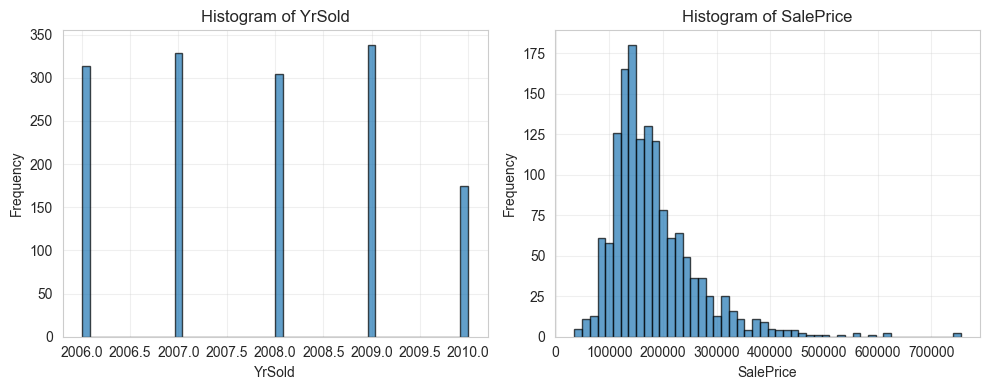

In [15]:
# Histograms
for i in range(0, len(numeric_cols), 5):
    batch = numeric_cols[i:i+5]
    fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
    if len(batch) == 1:
        axes = [axes]
    for j, col in enumerate(batch):
        axes[j].hist(data[col].dropna(), bins=50, edgecolor='black', alpha=0.7)
        axes[j].set_title(f'Histogram of {col}')
        axes[j].set_xlabel(col)
        axes[j].set_ylabel('Frequency')
        axes[j].grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

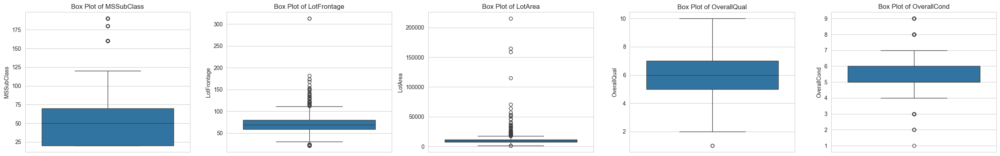

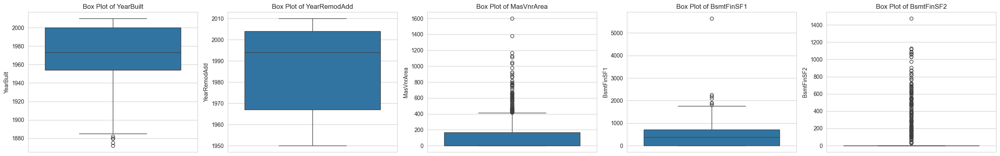

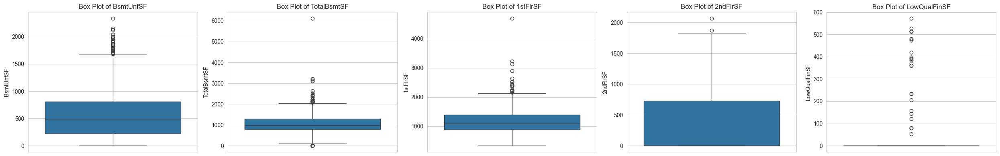

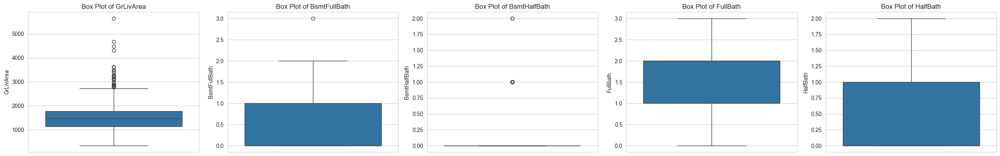

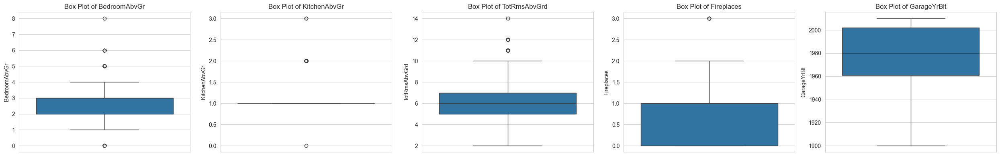

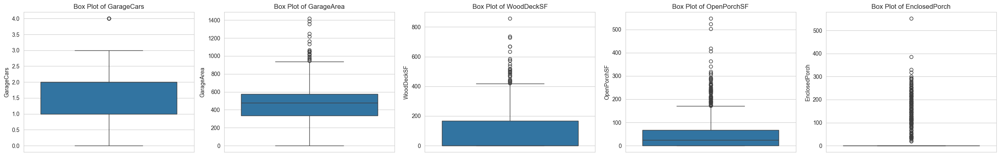

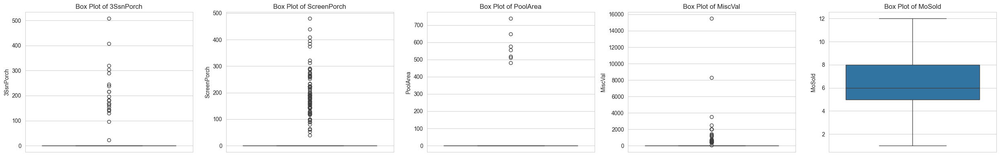

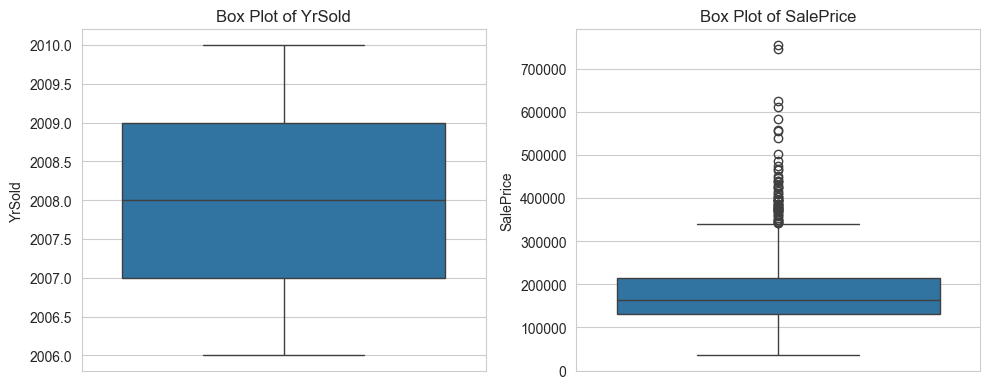

In [16]:
# Box plots
for i in range(0, len(numeric_cols), 5):
    batch = numeric_cols[i:i+5]
    fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
    if len(batch) == 1:
        axes = [axes]
    for j, col in enumerate(batch):
        sns.boxplot(y=data[col].dropna(), ax=axes[j])
        axes[j].set_title(f'Box Plot of {col}')
        axes[j].set_ylabel(col)
    plt.tight_layout()
    plt.show()

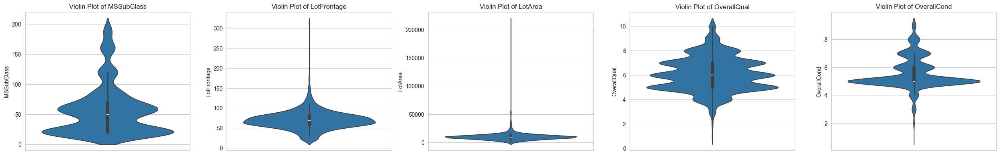

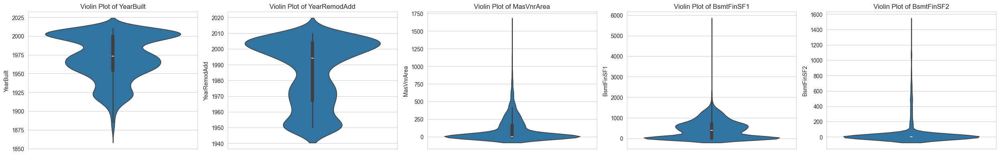

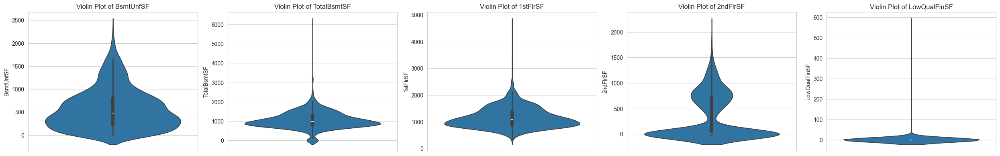

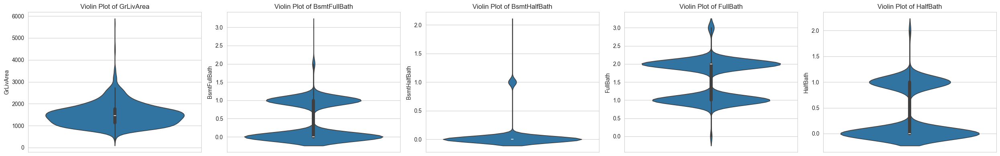

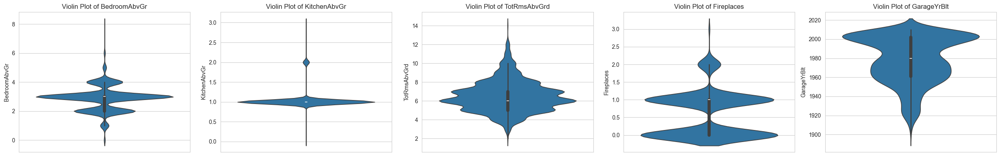

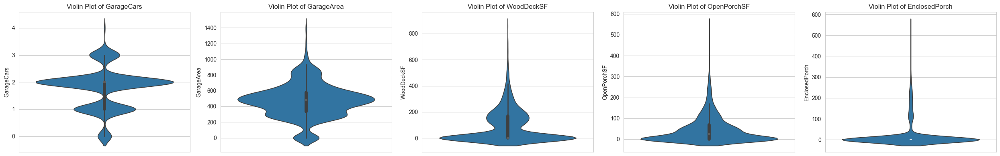

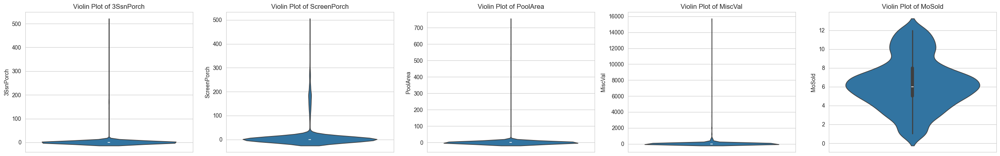

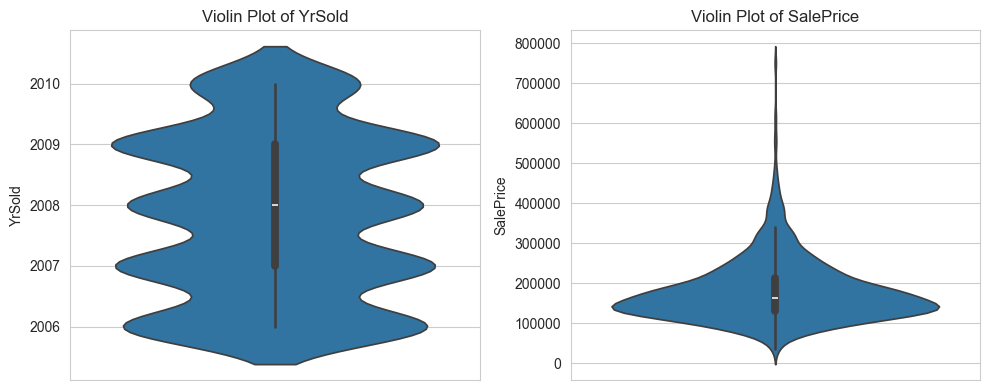

In [17]:
# Violin plots
for i in range(0, len(numeric_cols), 5):
    batch = numeric_cols[i:i+5]
    fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
    if len(batch) == 1:
        axes = [axes]
    for j, col in enumerate(batch):
        sns.violinplot(y=data[col].dropna(), ax=axes[j])
        axes[j].set_title(f'Violin Plot of {col}')
        axes[j].set_ylabel(col)
    plt.tight_layout()
    plt.show()

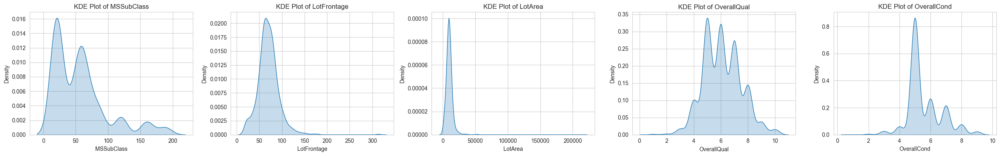

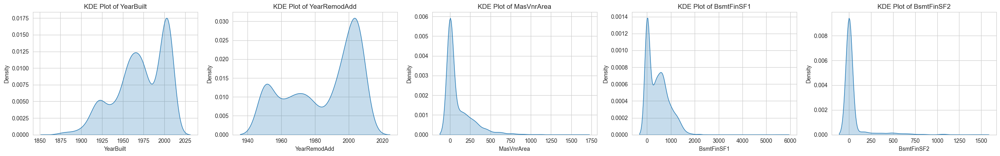

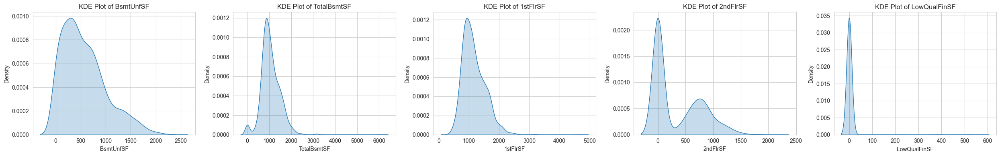

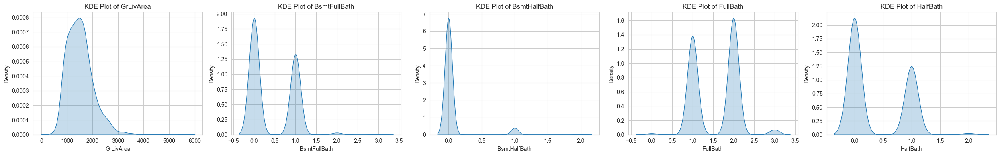

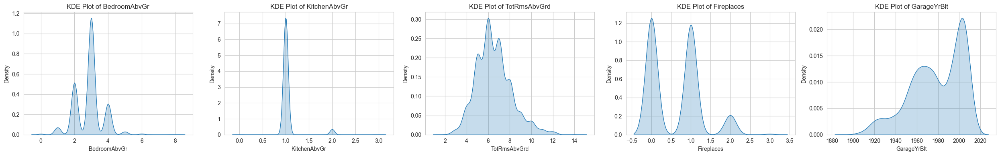

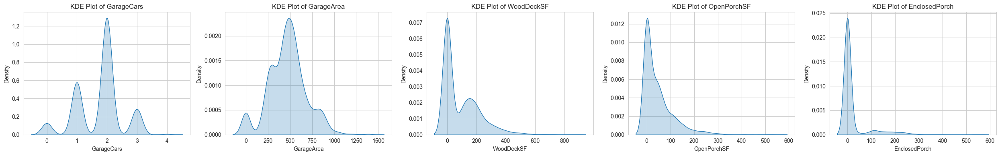

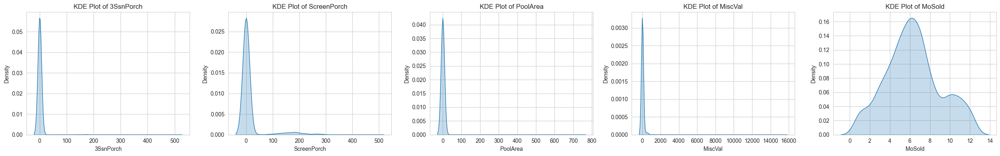

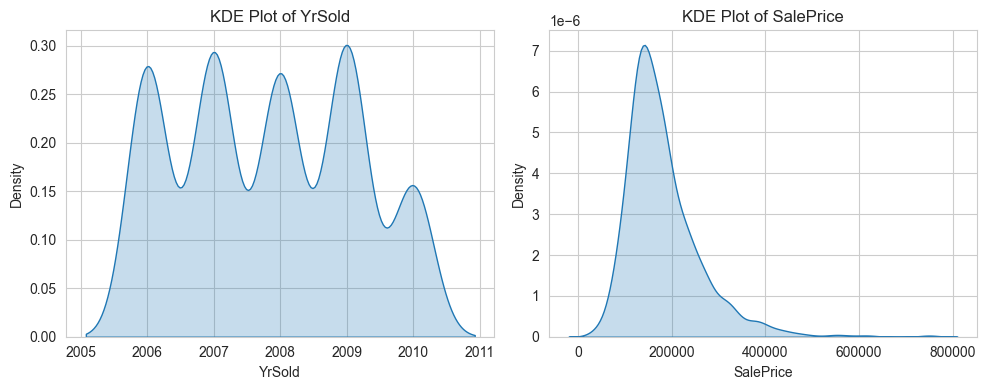

In [18]:
# KDE plots
for i in range(0, len(numeric_cols), 5):
    batch = numeric_cols[i:i+5]
    fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
    if len(batch) == 1:
        axes = [axes]
    for j, col in enumerate(batch):
        sns.kdeplot(data[col].dropna(), fill=True, ax=axes[j])
        axes[j].set_title(f'KDE Plot of {col}')
        axes[j].set_xlabel(col)
        axes[j].set_ylabel('Density')
    plt.tight_layout()
    plt.show()

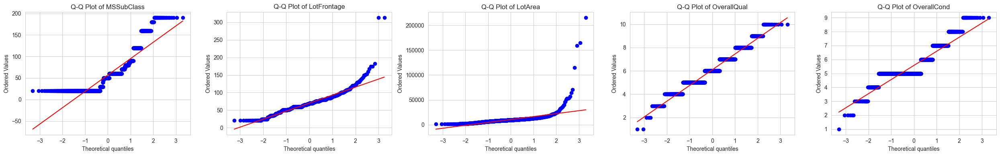

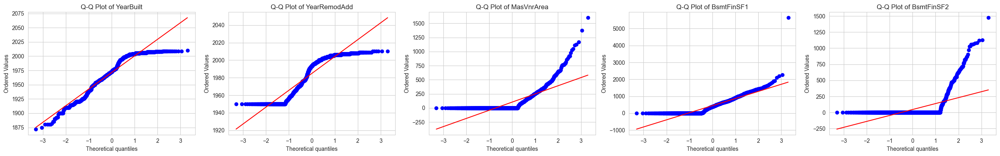

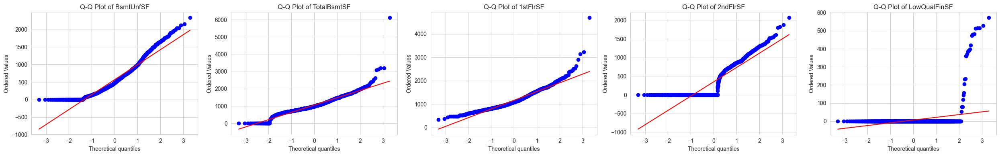

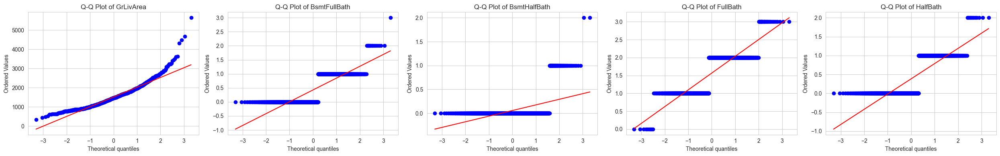

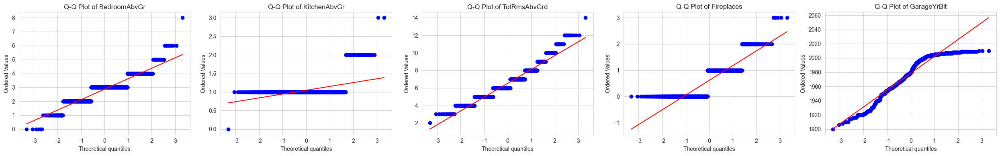

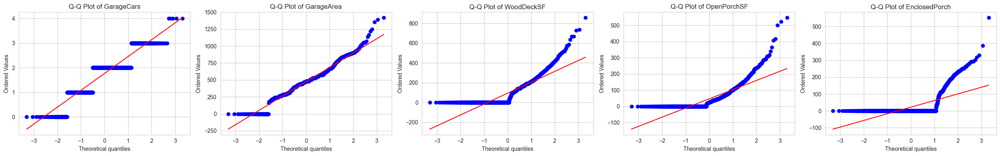

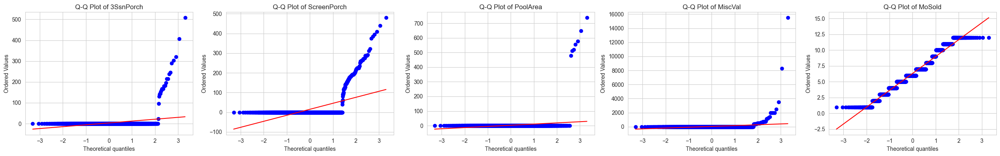

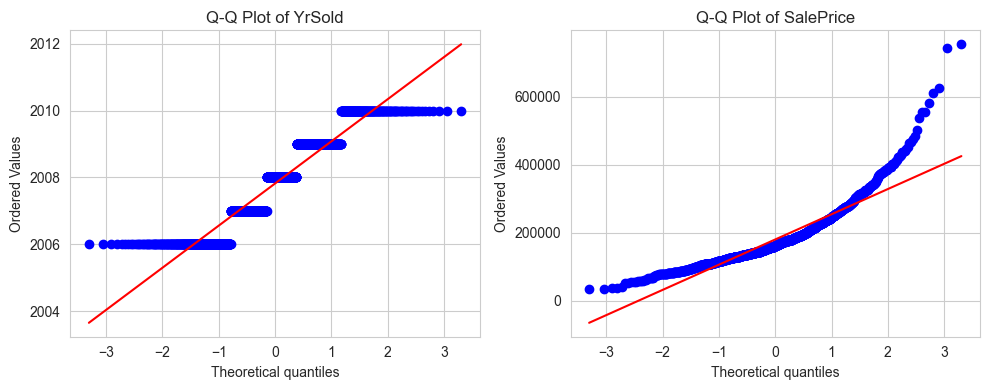

In [19]:
# Q-Q plots
for i in range(0, len(numeric_cols), 5):
    batch = numeric_cols[i:i+5]
    fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
    if len(batch) == 1:
        axes = [axes]
    for j, col in enumerate(batch):
        stats.probplot(data[col].dropna(), dist="norm", plot=axes[j])
        axes[j].set_title(f'Q-Q Plot of {col}')
    plt.tight_layout()
    plt.show()

## CATEGORICAL VARIABLE PLOTS

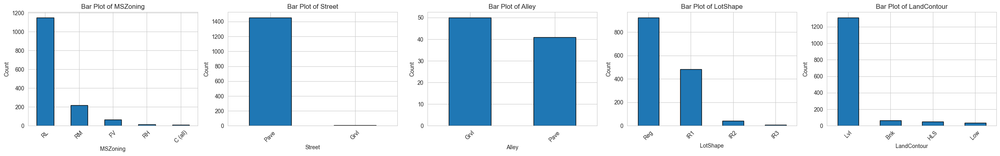

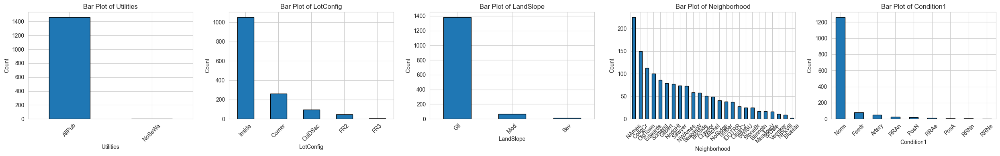

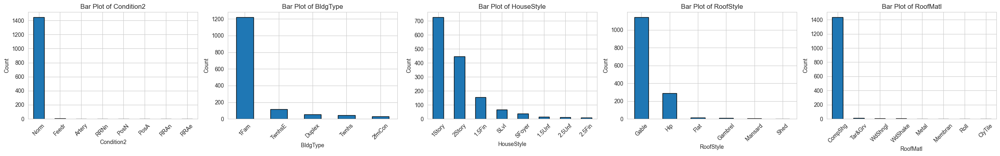

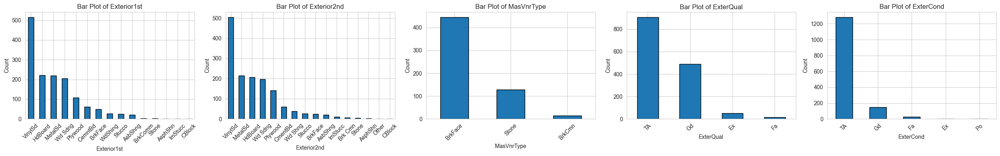

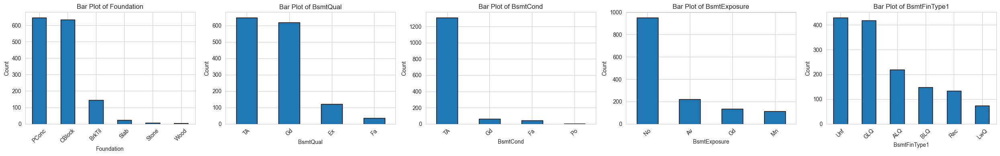

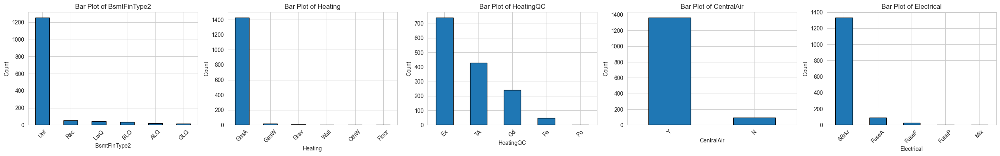

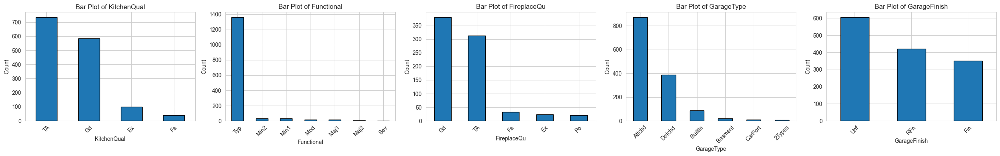

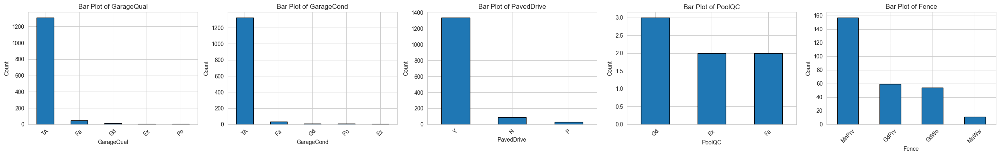

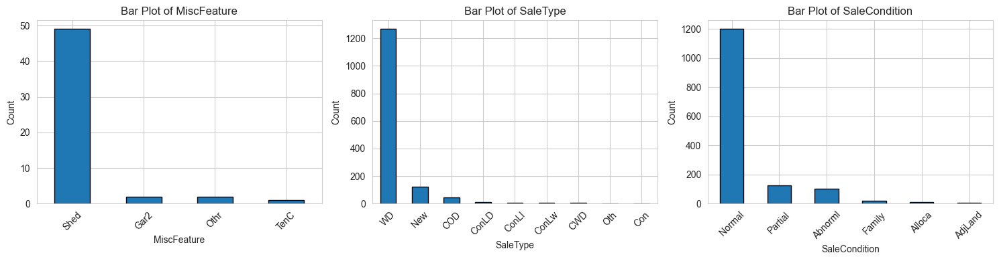

In [20]:
# Bar plots
for i in range(0, len(categorical_cols), 5):
    batch = categorical_cols[i:i+5]
    fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
    if len(batch) == 1:
        axes = [axes]
    for j, col in enumerate(batch):
        data[col].value_counts().plot(kind='bar', ax=axes[j], edgecolor='black')
        axes[j].set_title(f'Bar Plot of {col}')
        axes[j].set_xlabel(col)
        axes[j].set_ylabel('Count')
        axes[j].tick_params(axis='x', rotation=45)
    plt.tight_layout()
    plt.show()

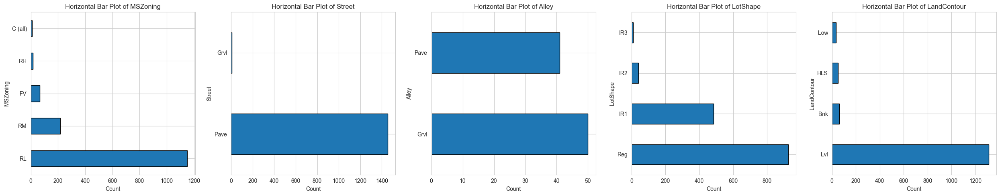

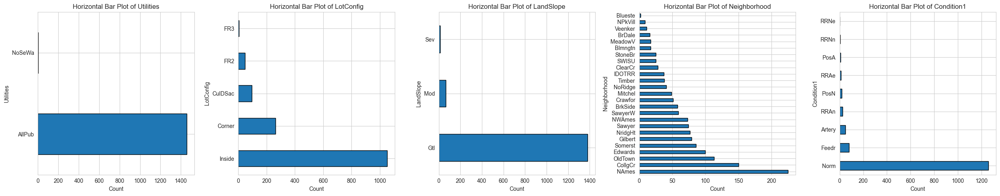

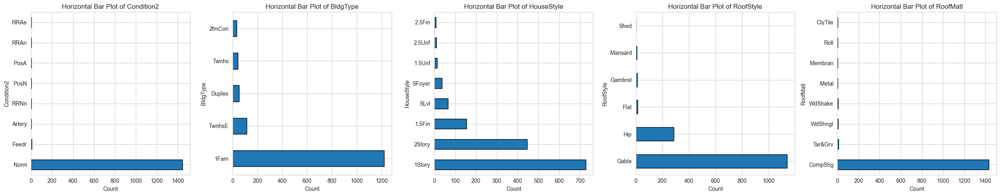

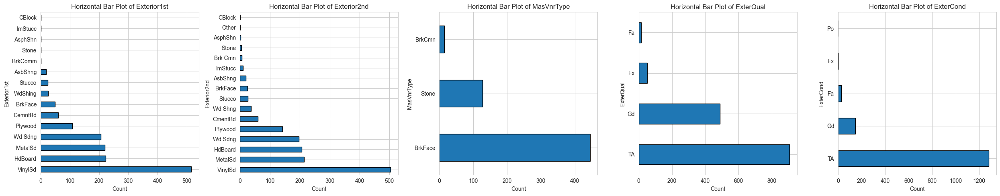

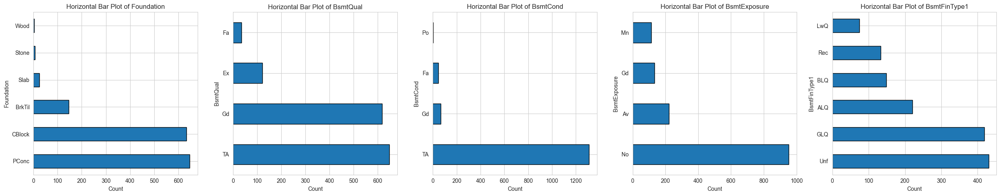

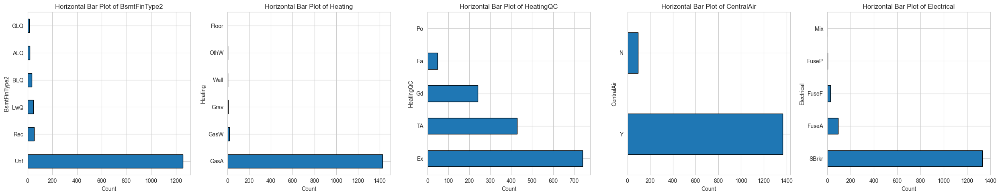

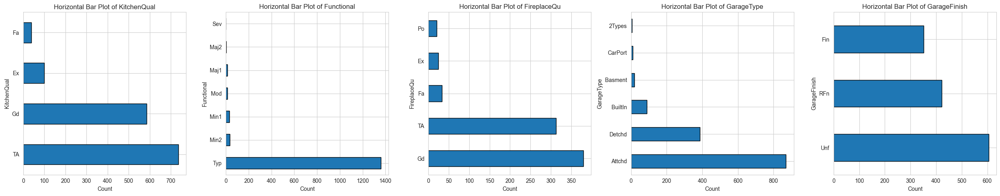

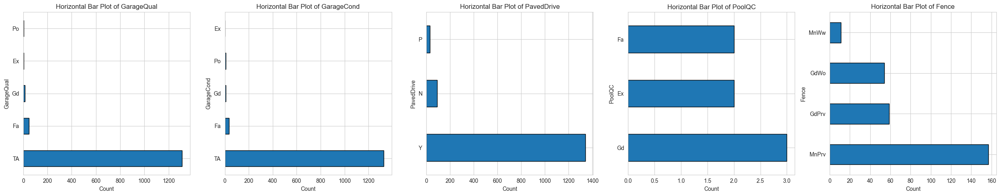

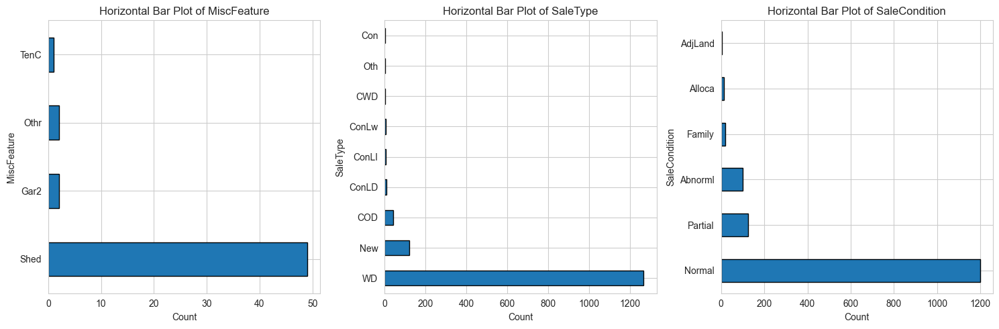

In [21]:
# Horizontal bar plots
for i in range(0, len(categorical_cols), 5):
    batch = categorical_cols[i:i+5]
    fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 5))
    if len(batch) == 1:
        axes = [axes]
    for j, col in enumerate(batch):
        data[col].value_counts().plot(kind='barh', ax=axes[j], edgecolor='black')
        axes[j].set_title(f'Horizontal Bar Plot of {col}')
        axes[j].set_xlabel('Count')
        axes[j].set_ylabel(col)
    plt.tight_layout()
    plt.show()

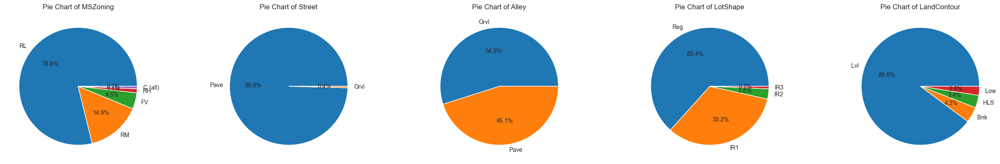

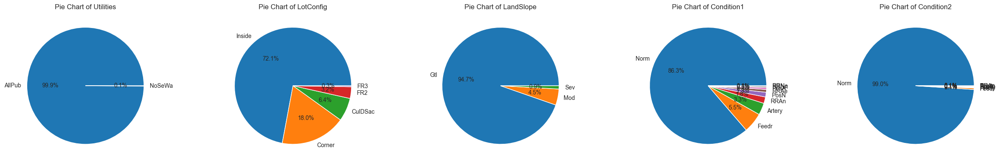

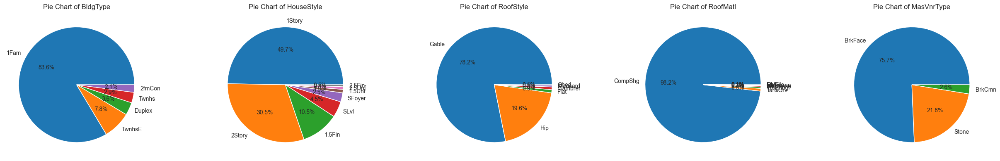

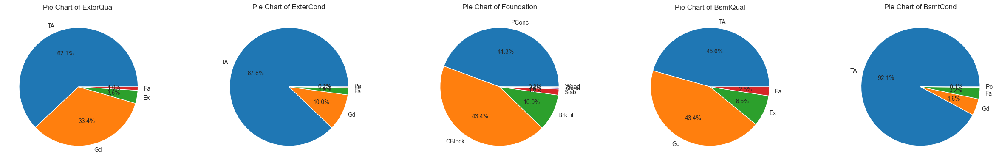

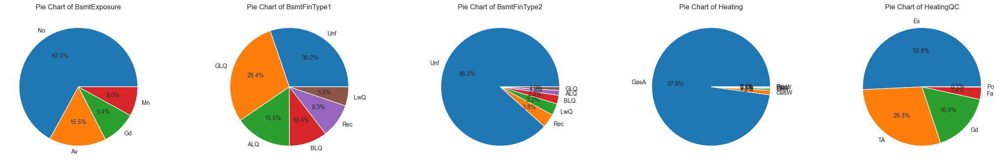

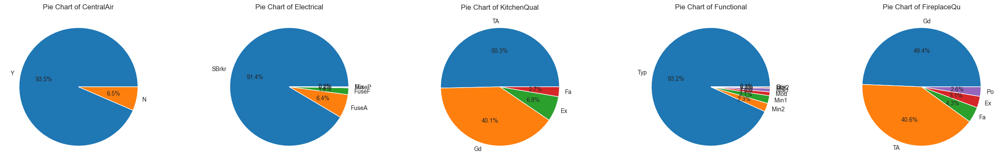

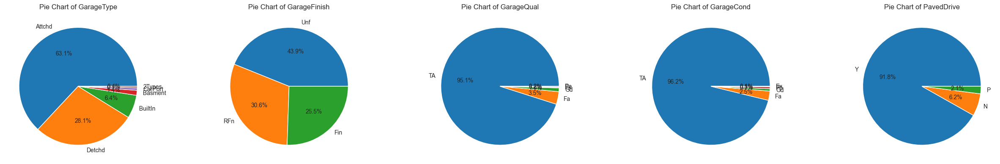

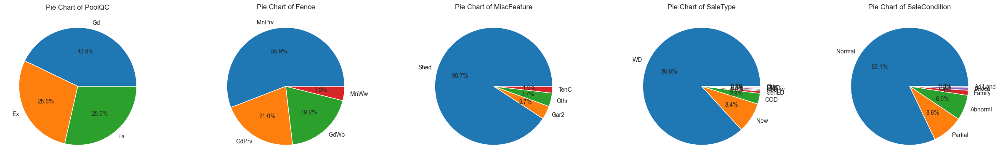

In [22]:
# Pie charts (for categories with <= 10 unique values)
pie_cols = [col for col in categorical_cols if data[col].nunique() <= 10]
for i in range(0, len(pie_cols), 5):
    batch = pie_cols[i:i+5]
    fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
    if len(batch) == 1:
        axes = [axes]
    for j, col in enumerate(batch):
        data[col].value_counts().plot(kind='pie', autopct='%1.1f%%', ax=axes[j])
        axes[j].set_title(f'Pie Chart of {col}')
        axes[j].set_ylabel('')
    plt.tight_layout()
    plt.show()

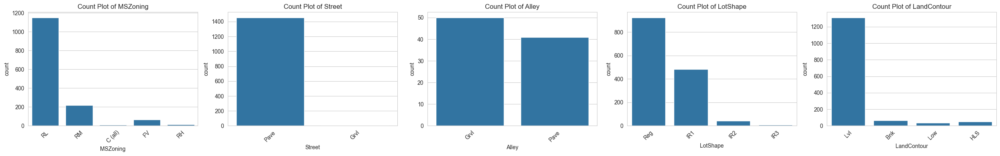

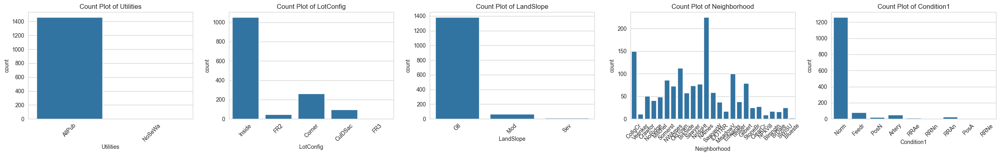

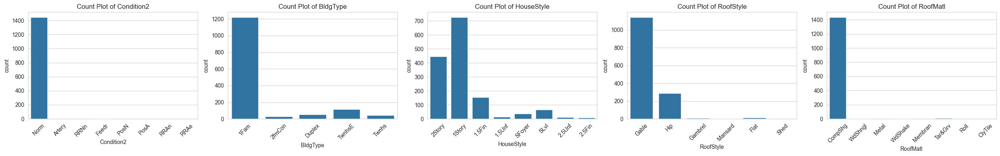

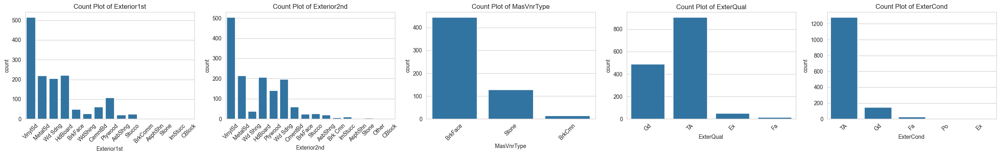

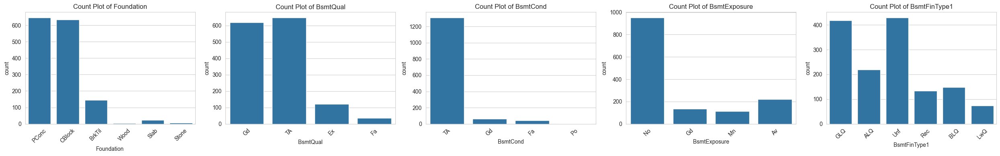

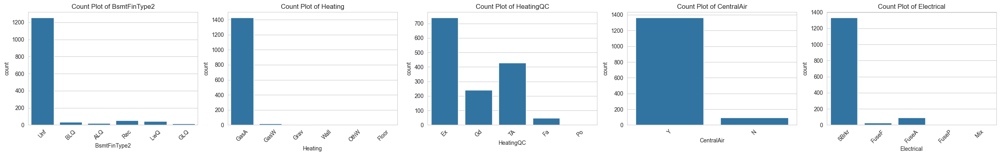

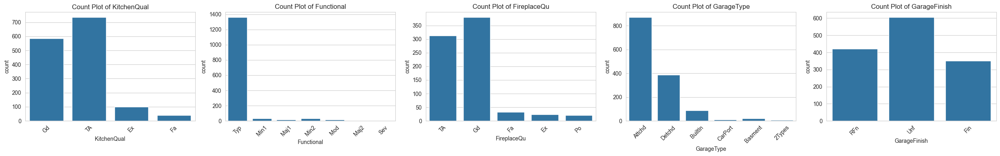

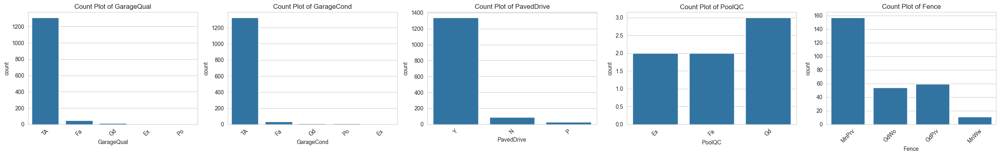

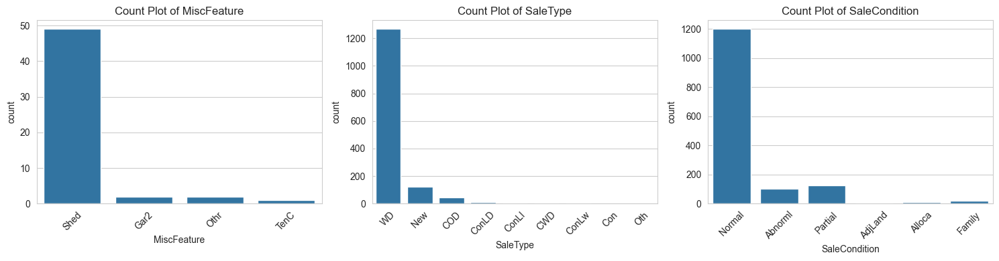

In [23]:
# Count plots
for i in range(0, len(categorical_cols), 5):
    batch = categorical_cols[i:i+5]
    fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
    if len(batch) == 1:
        axes = [axes]
    for j, col in enumerate(batch):
        sns.countplot(data=data, x=col, ax=axes[j])
        axes[j].set_title(f'Count Plot of {col}')
        axes[j].tick_params(axis='x', rotation=45)
    plt.tight_layout()
    plt.show()

## CORRELATION ANALYSIS

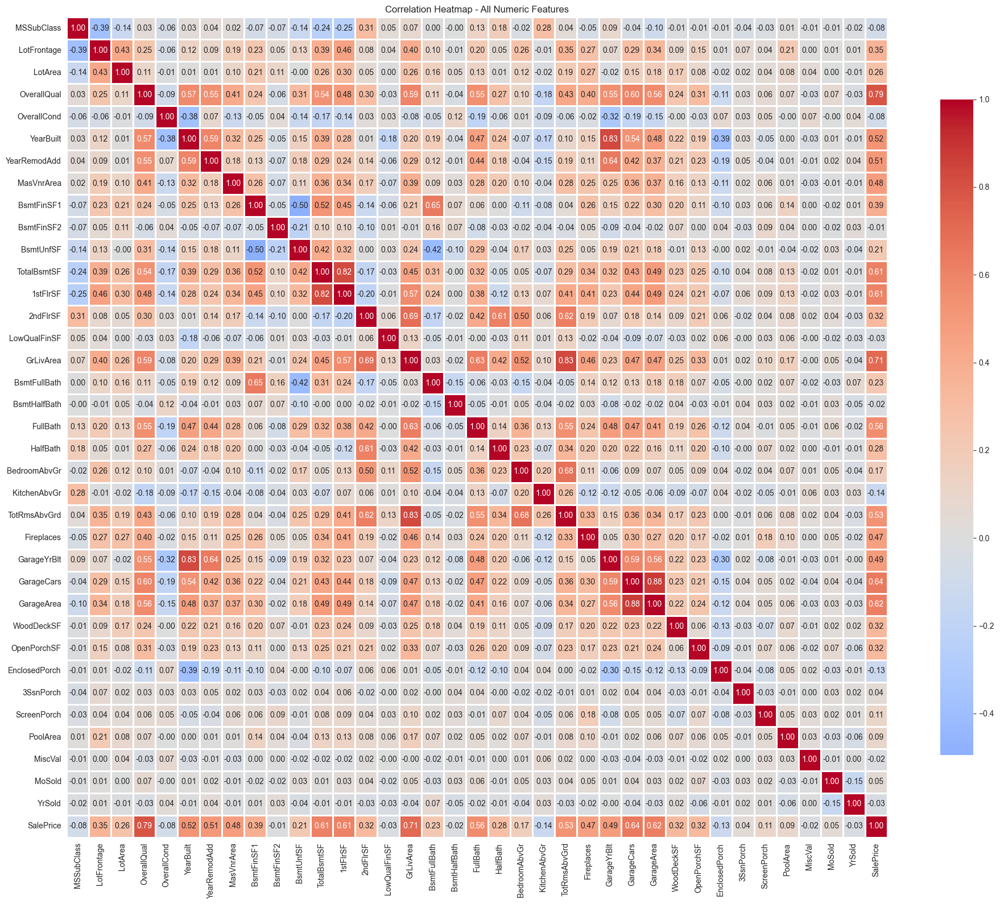

In [24]:
# Correlation heatmap
plt.figure(figsize=(20, 16))
corr_matrix = data[numeric_cols].corr()
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', center=0, 
            square=True, linewidths=1, cbar_kws={"shrink": 0.8})
plt.title('Correlation Heatmap - All Numeric Features')
plt.tight_layout()
plt.show()

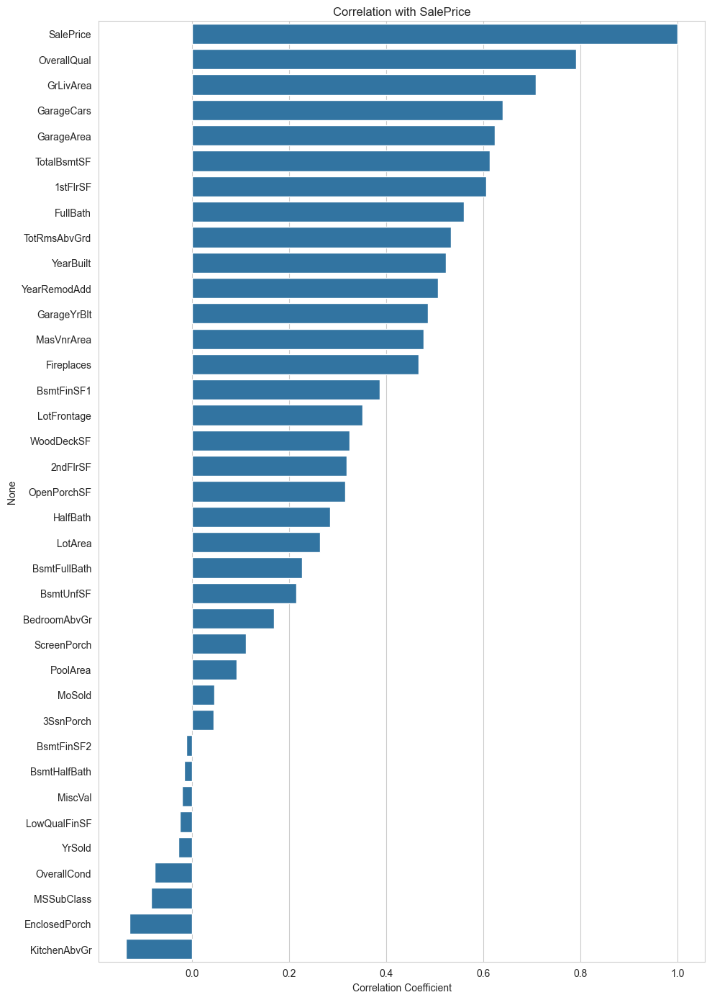

In [25]:
# Correlation with SalePrice
if 'SalePrice' in numeric_cols:
    plt.figure(figsize=(10, 14))
    corr_with_price = data[numeric_cols].corr()['SalePrice'].sort_values(ascending=False)
    sns.barplot(x=corr_with_price.values, y=corr_with_price.index)
    plt.title('Correlation with SalePrice')
    plt.xlabel('Correlation Coefficient')
    plt.tight_layout()
    plt.show()

## SCATTER PLOTS (All numeric vs all numeric)

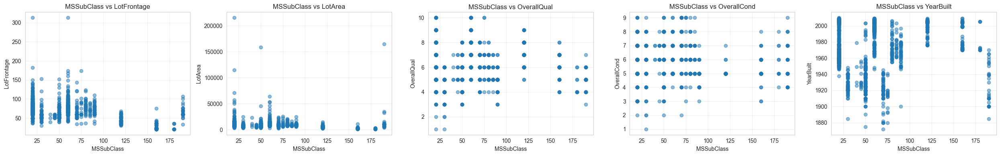

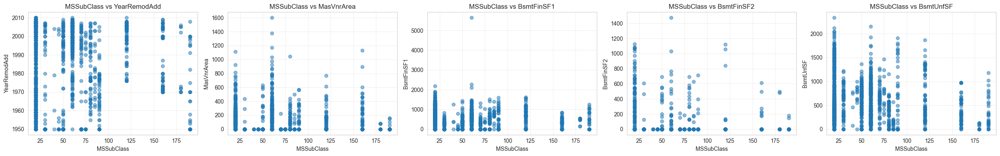

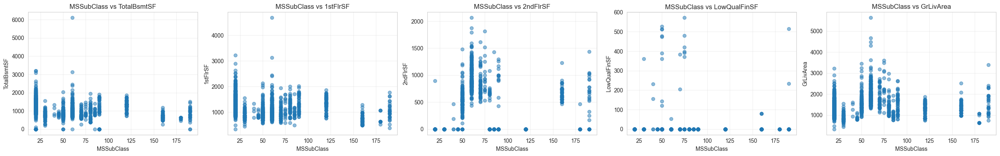

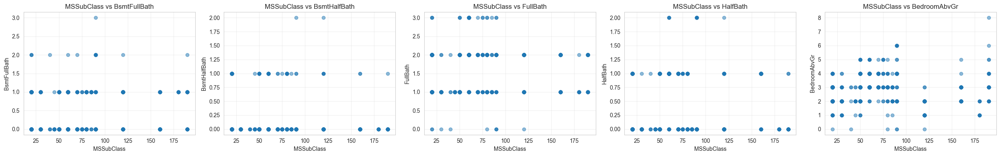

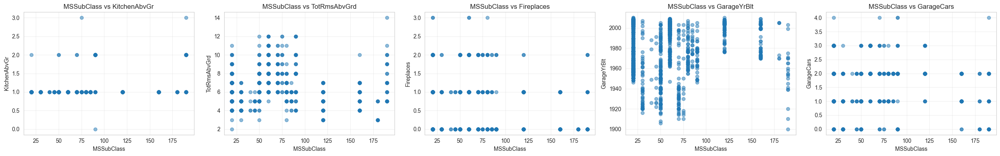

...

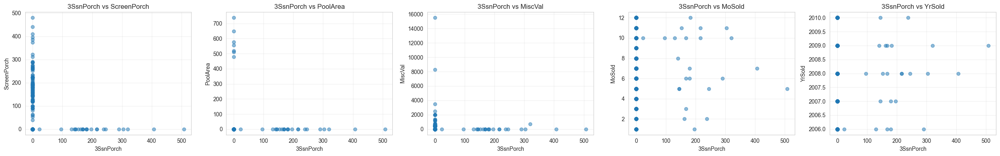

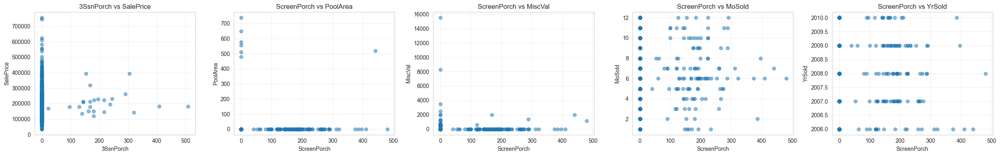

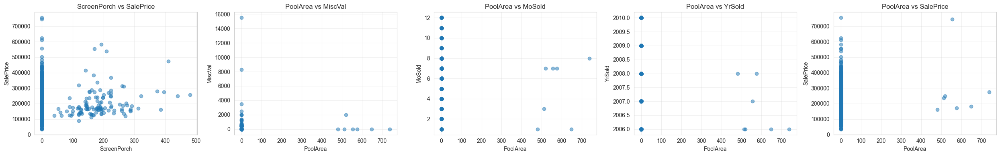

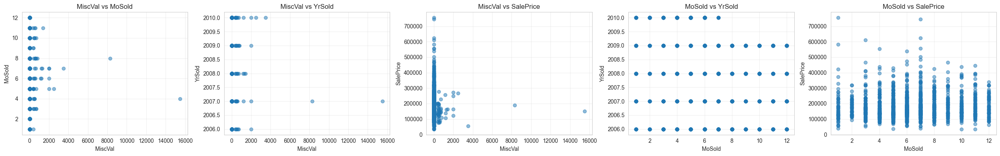

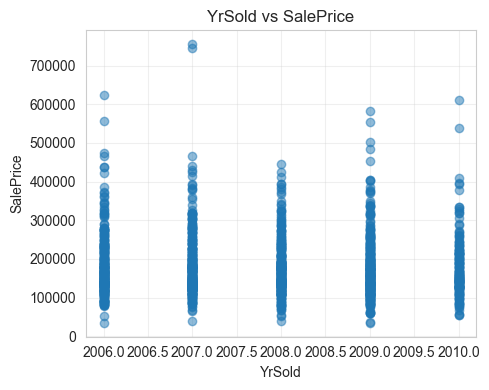

In [26]:
all_pairs = []
for i, col1 in enumerate(numeric_cols):
    for col2 in numeric_cols[i+1:]:
        all_pairs.append((col1, col2))

for i in range(0, len(all_pairs), 5):
    batch = all_pairs[i:i+5]
    fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
    if len(batch) == 1:
        axes = [axes]
    for j, (col1, col2) in enumerate(batch):
        axes[j].scatter(data[col1], data[col2], alpha=0.5)
        axes[j].set_title(f'{col1} vs {col2}')
        axes[j].set_xlabel(col1)
        axes[j].set_ylabel(col2)
        axes[j].grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

## SCATTER PLOTS WITH REGRESSION LINE

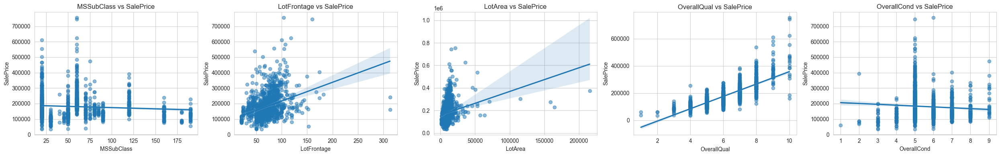

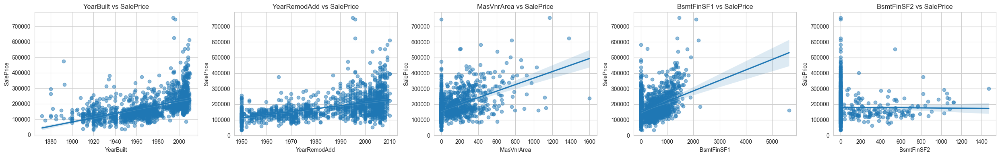

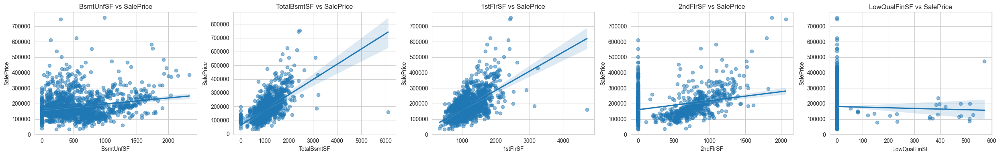

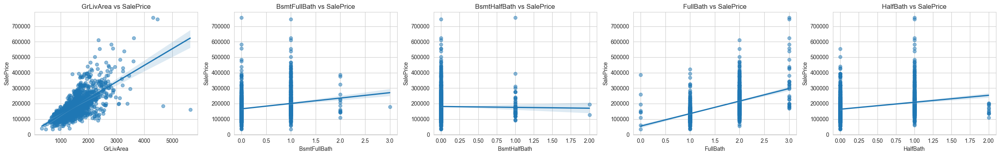

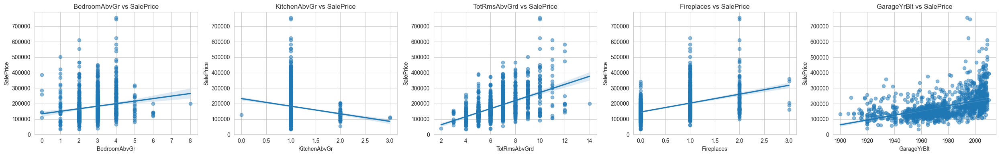

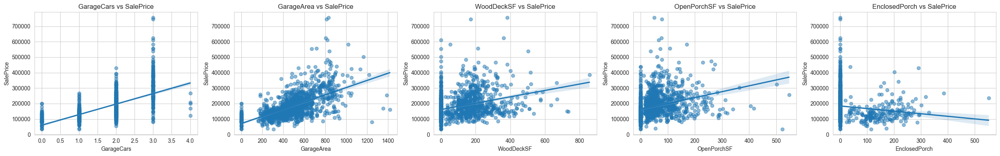

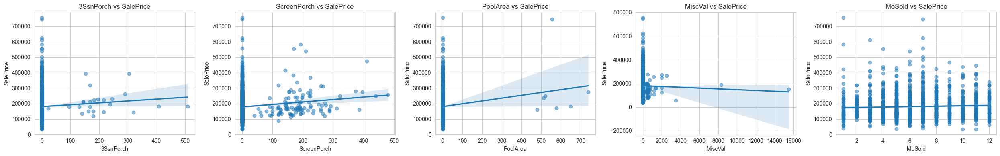

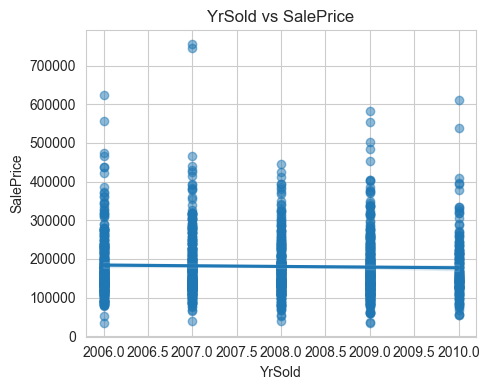

In [27]:
if 'SalePrice' in data.columns:
    sp_cols = [col for col in numeric_cols if col != 'SalePrice']
    for i in range(0, len(sp_cols), 5):
        batch = sp_cols[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            sns.regplot(x=data[col], y=data['SalePrice'], scatter_kws={'alpha':0.5}, ax=axes[j])
            axes[j].set_title(f'{col} vs SalePrice')
            axes[j].set_xlabel(col)
            axes[j].set_ylabel('SalePrice')
        plt.tight_layout()
        plt.show()

## BOX PLOTS (Categorical vs SalePrice)

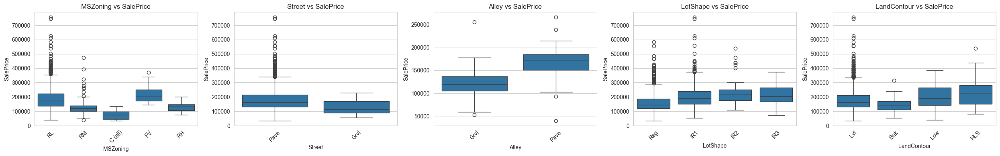

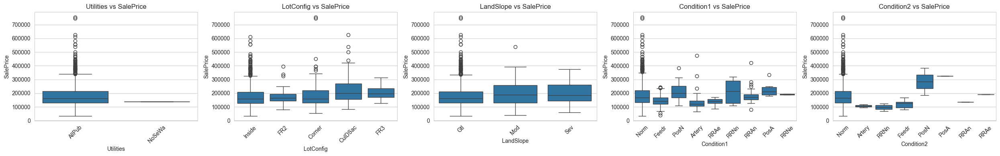

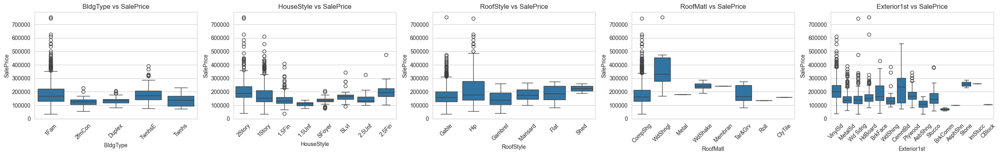

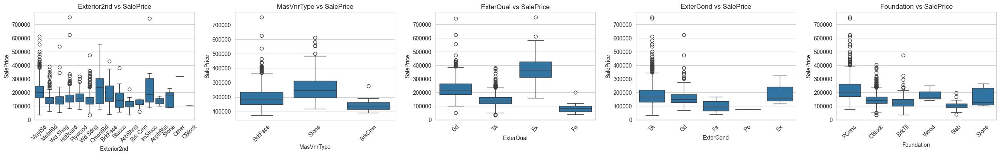

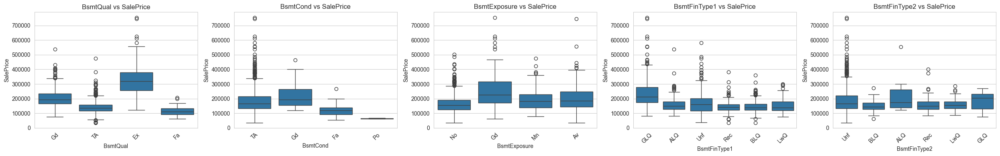

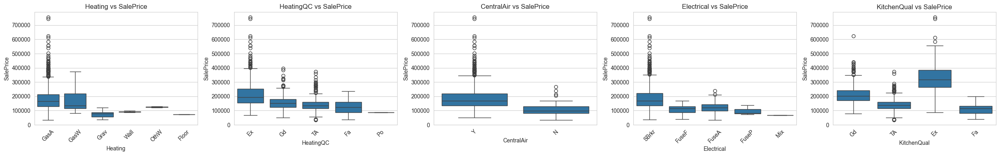

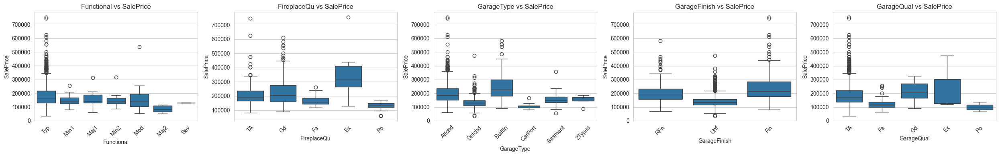

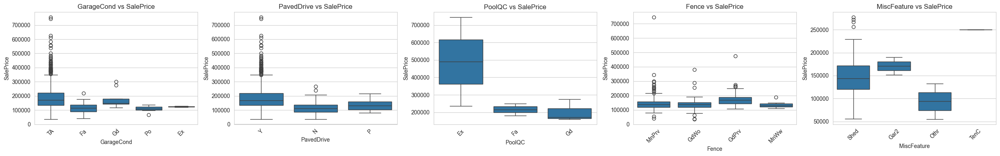

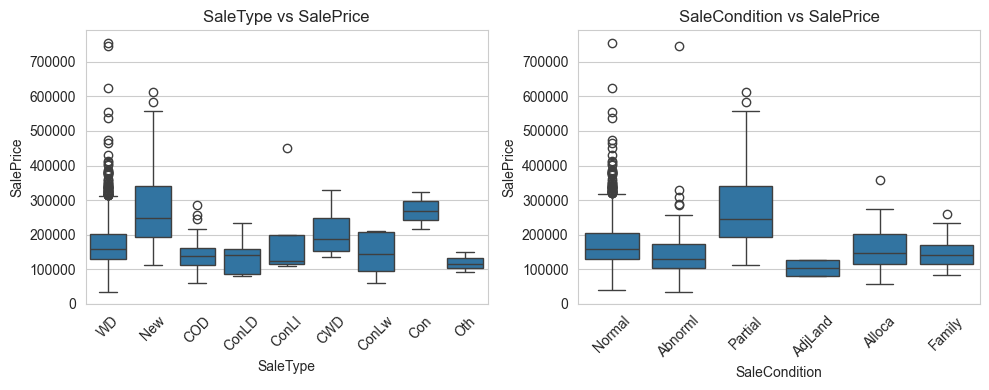

In [28]:
if 'SalePrice' in data.columns:
    cat_small = [col for col in categorical_cols if data[col].nunique() <= 20]
    for i in range(0, len(cat_small), 5):
        batch = cat_small[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            sns.boxplot(data=data, x=col, y='SalePrice', ax=axes[j])
            axes[j].set_title(f'{col} vs SalePrice')
            axes[j].tick_params(axis='x', rotation=45)
        plt.tight_layout()
        plt.show()

## VIOLIN PLOTS (Categorical vs SalePrice)

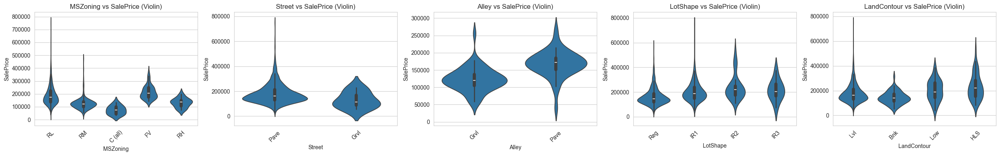

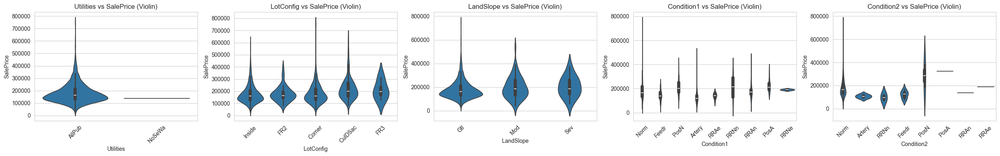

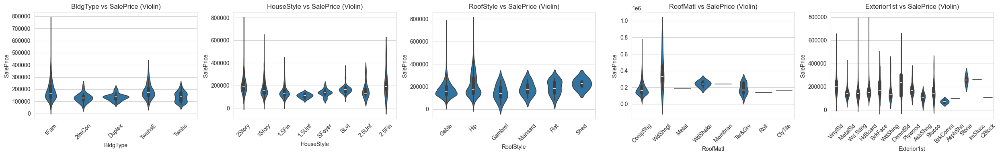

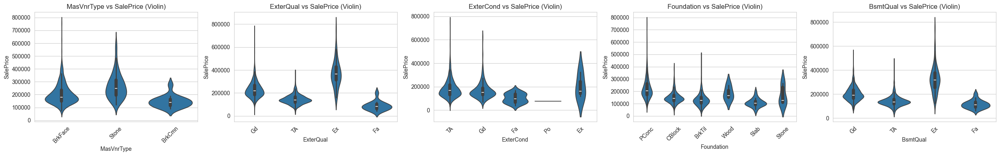

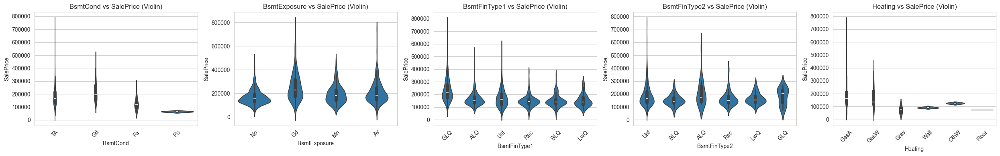

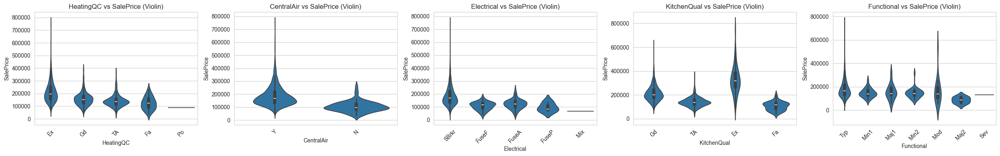

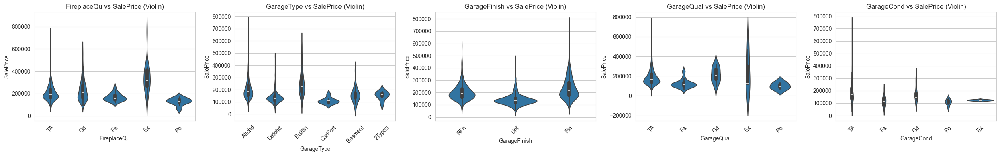

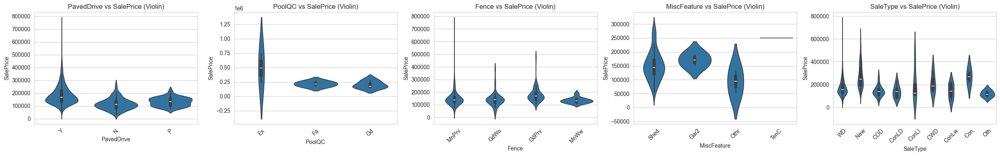

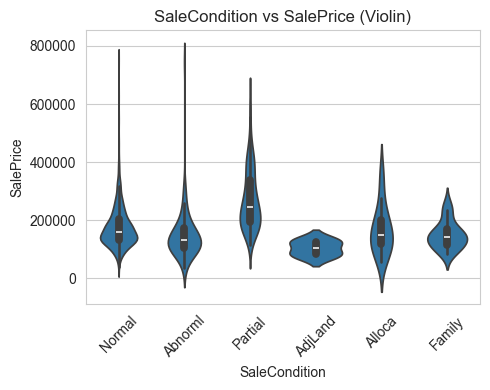

In [29]:
if 'SalePrice' in data.columns:
    cat_medium = [col for col in categorical_cols if data[col].nunique() <= 15]
    for i in range(0, len(cat_medium), 5):
        batch = cat_medium[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            sns.violinplot(data=data, x=col, y='SalePrice', ax=axes[j])
            axes[j].set_title(f'{col} vs SalePrice (Violin)')
            axes[j].tick_params(axis='x', rotation=45)
        plt.tight_layout()
        plt.show()

## STRIP PLOTS (Categorical vs Numeric)

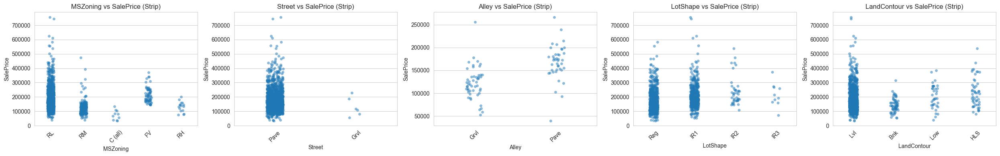

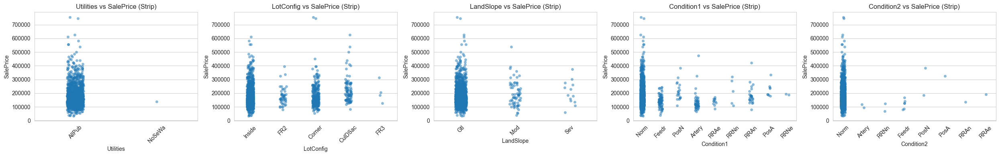

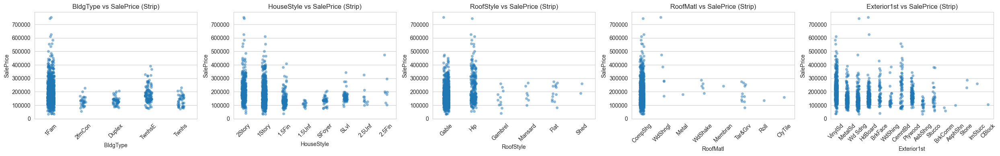

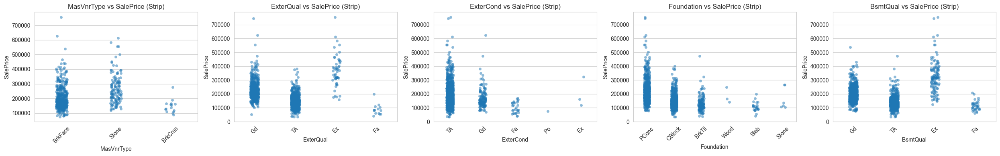

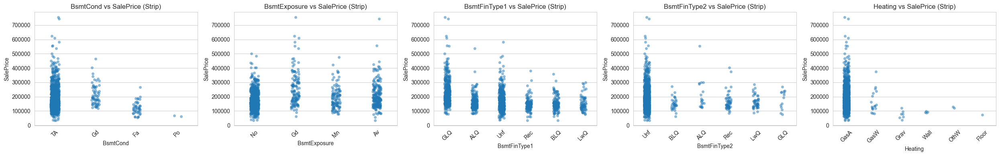

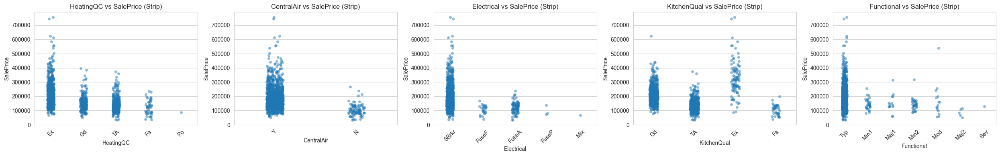

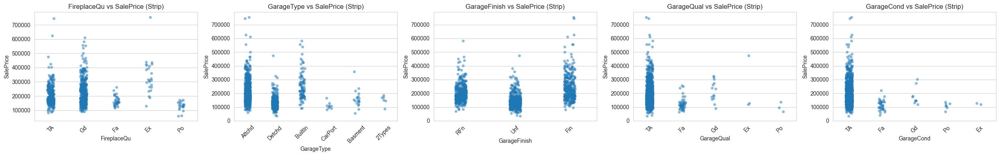

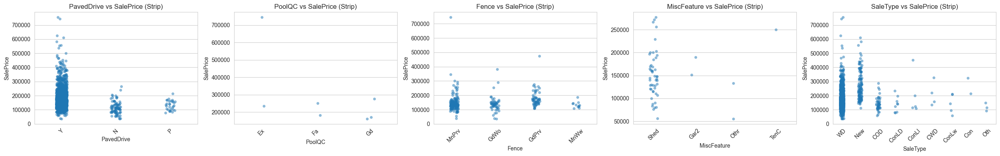

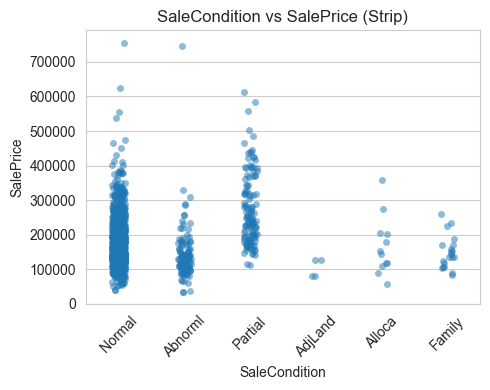

In [30]:
if 'SalePrice' in data.columns:
    for i in range(0, len(cat_medium), 5):
        batch = cat_medium[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            sns.stripplot(data=data, x=col, y='SalePrice', alpha=0.5, ax=axes[j])
            axes[j].set_title(f'{col} vs SalePrice (Strip)')
            axes[j].tick_params(axis='x', rotation=45)
        plt.tight_layout()
        plt.show()

## SWARM PLOTS (for smaller categories)

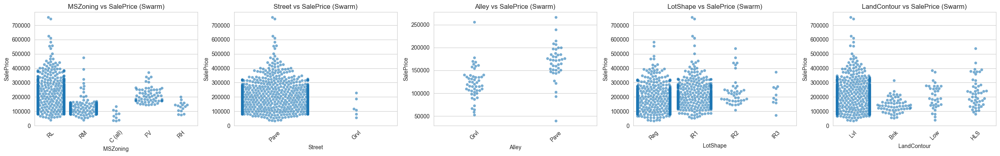

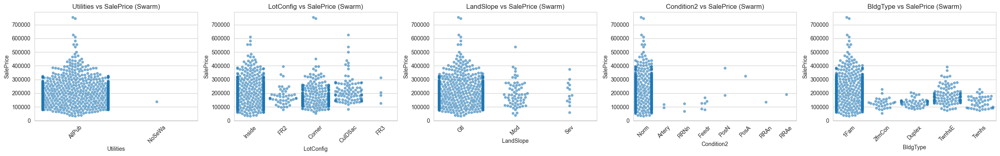

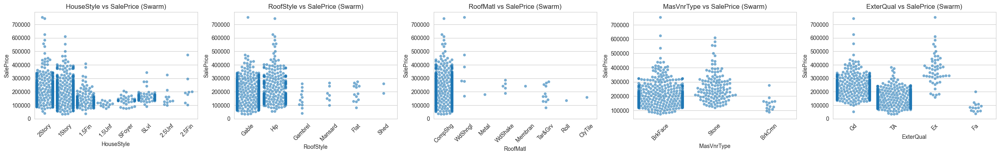

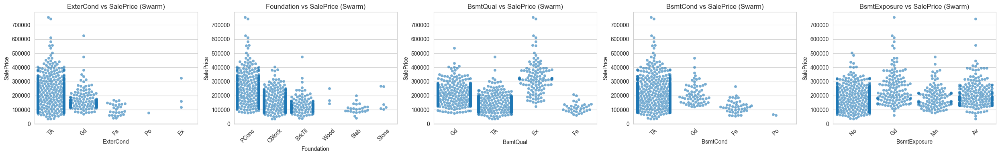

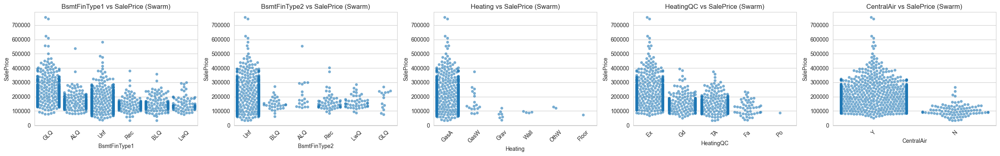

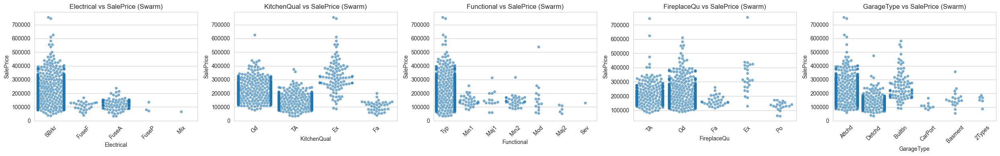

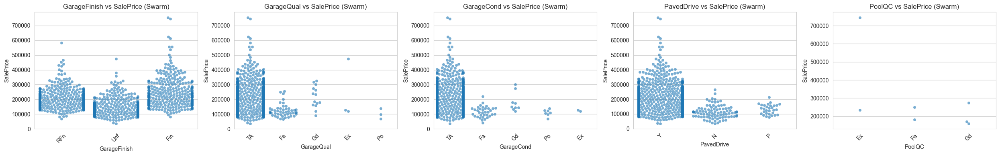

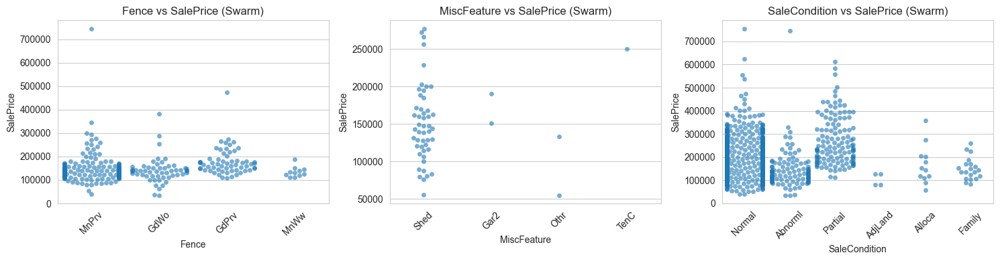

In [31]:
if 'SalePrice' in data.columns:
    cat_tiny = [col for col in categorical_cols if data[col].nunique() <= 8]
    for i in range(0, len(cat_tiny), 5):
        batch = cat_tiny[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            sns.swarmplot(data=data, x=col, y='SalePrice', alpha=0.6, ax=axes[j])
            axes[j].set_title(f'{col} vs SalePrice (Swarm)')
            axes[j].tick_params(axis='x', rotation=45)
        plt.tight_layout()
        plt.show()

## PAIR PLOTS (for subsets)

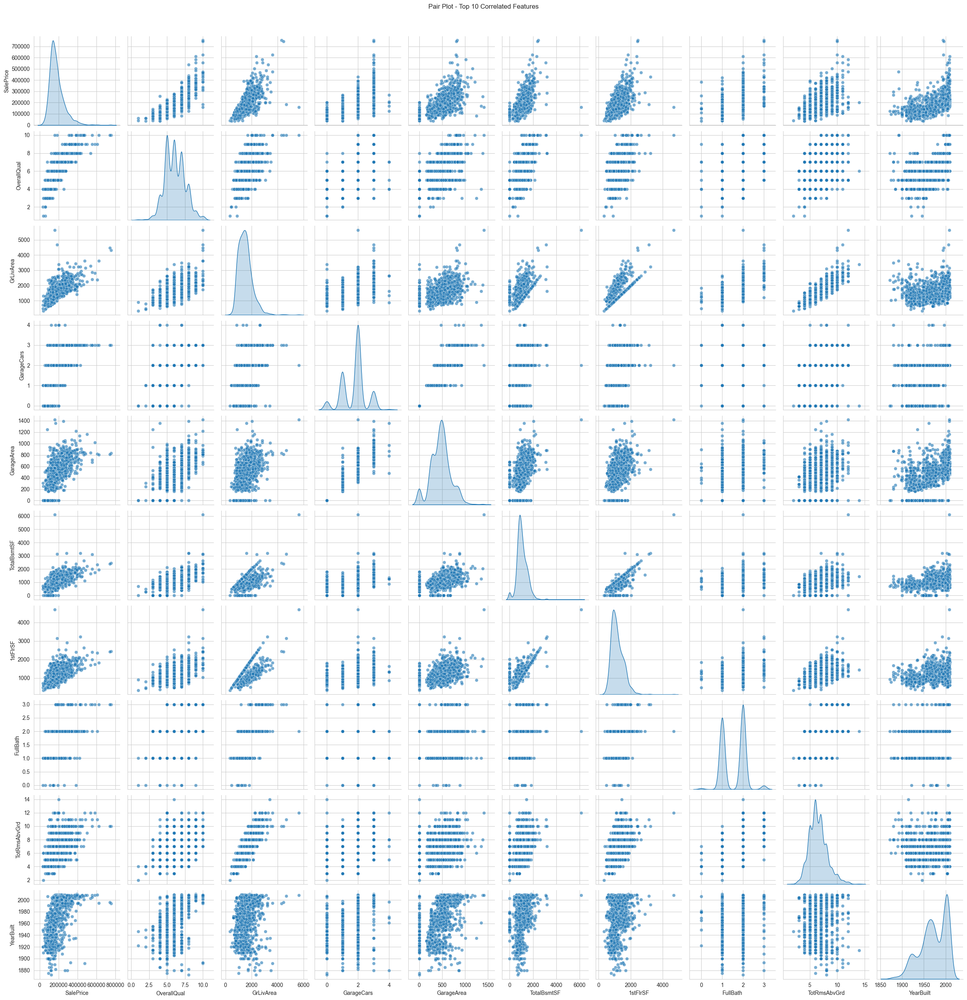

In [32]:
# Top correlated features with SalePrice
if 'SalePrice' in data.columns:
    top_corr = data[numeric_cols].corr()['SalePrice'].abs().sort_values(ascending=False)[:10].index.tolist()
    sns.pairplot(data[top_corr], diag_kind='kde', plot_kws={'alpha':0.6})
    plt.suptitle('Pair Plot - Top 10 Correlated Features', y=1.02)
    plt.show()

## JOINT PLOTS

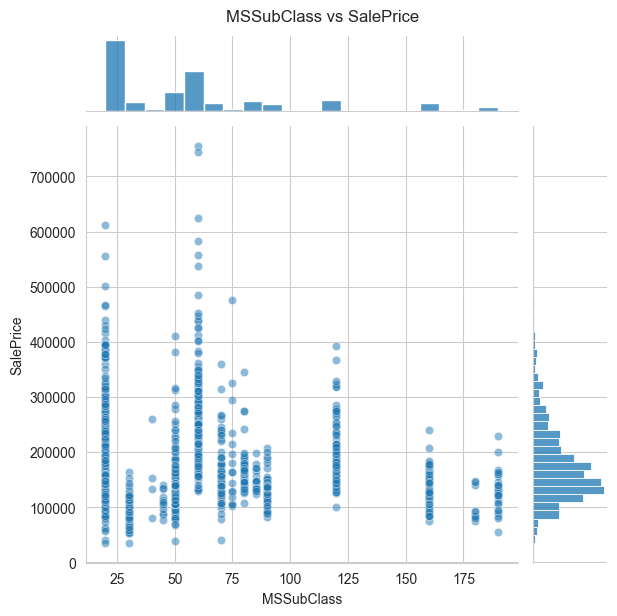

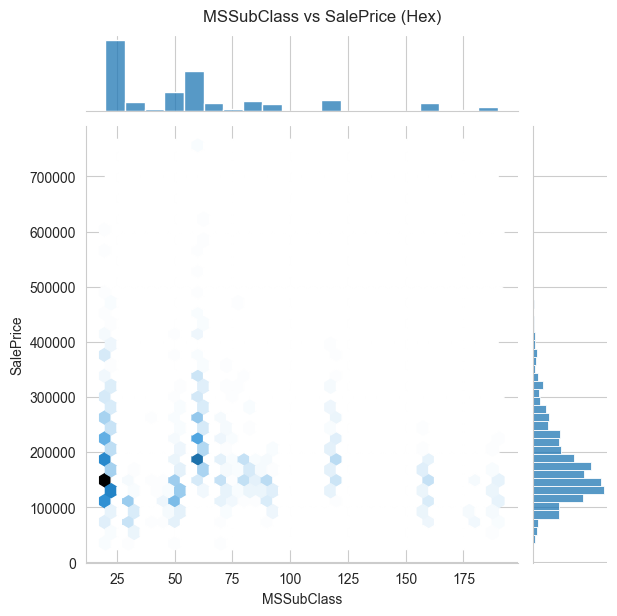

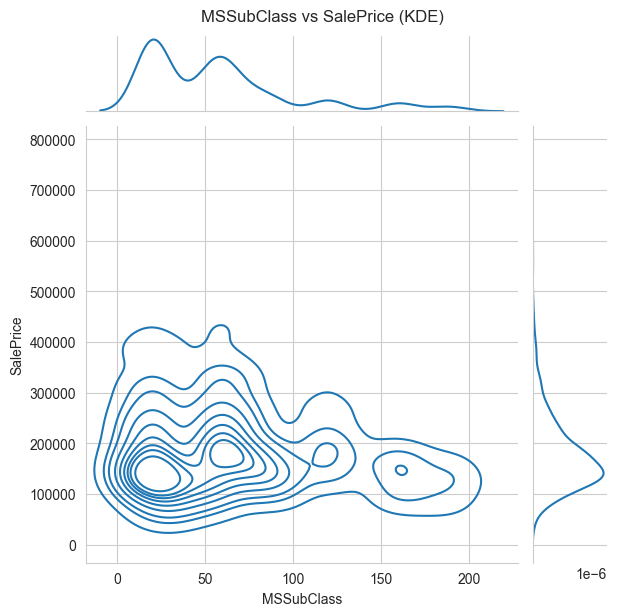

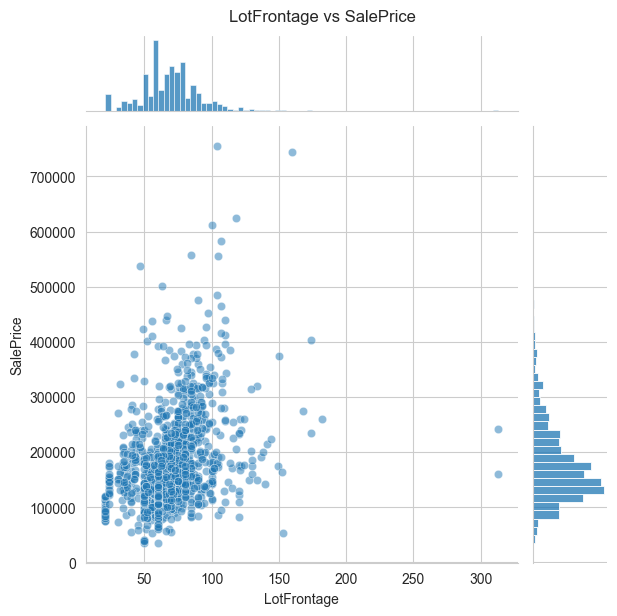

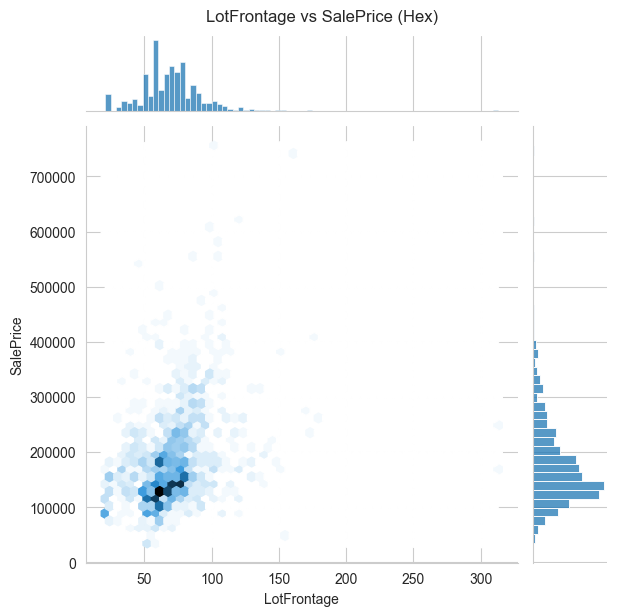

...

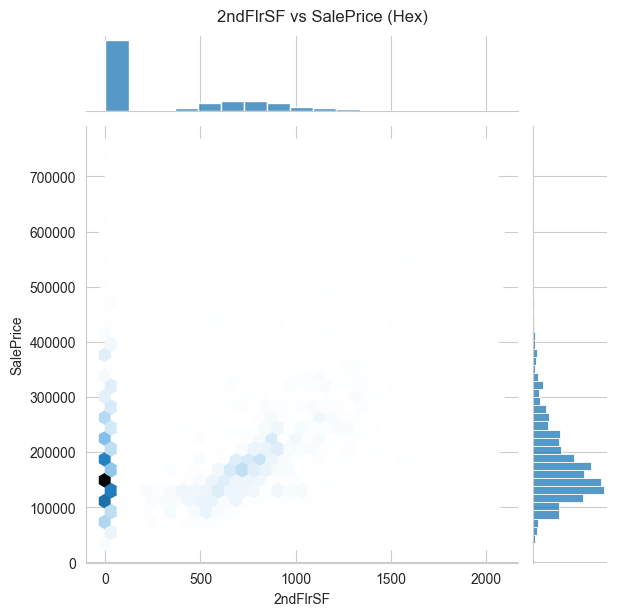

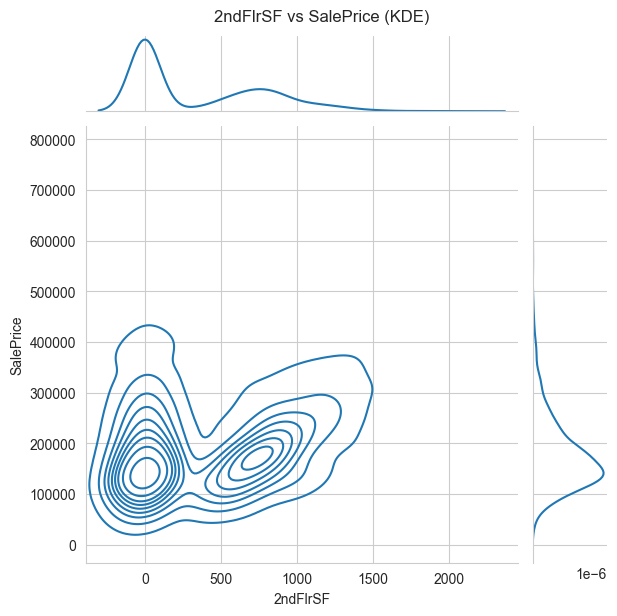

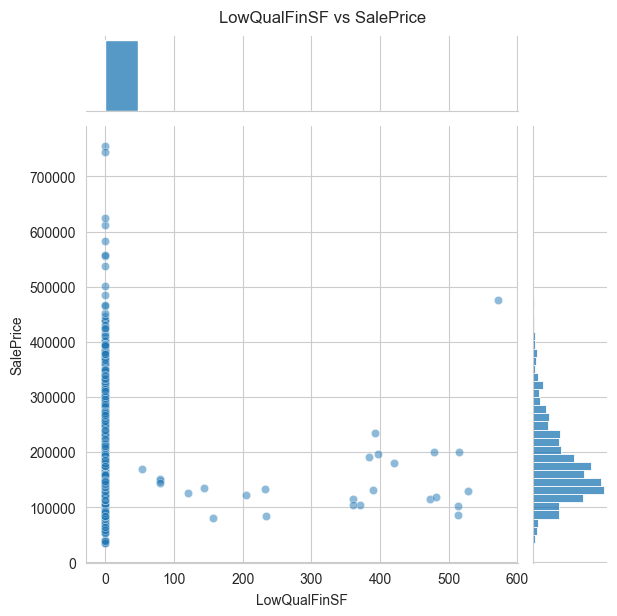

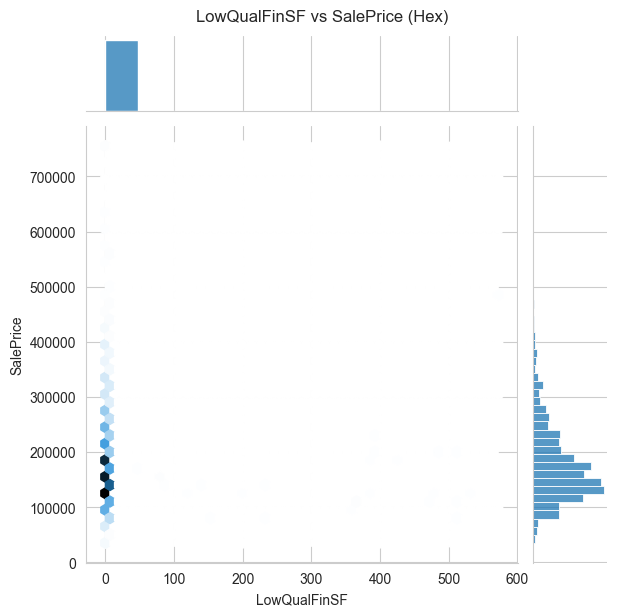

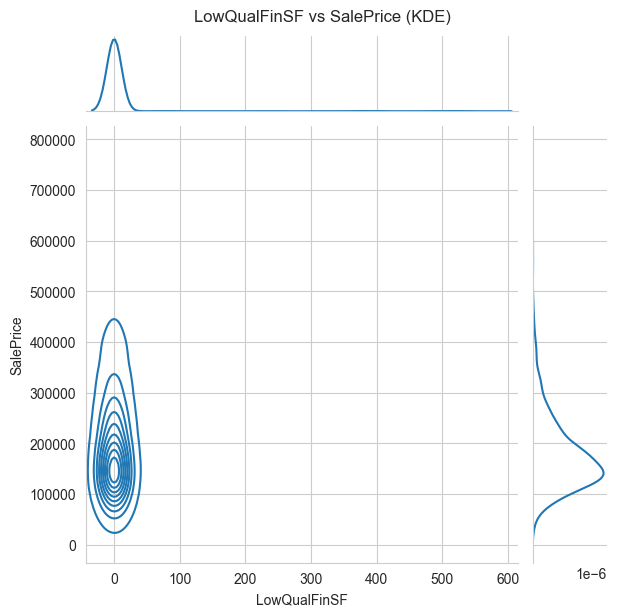

In [33]:
if 'SalePrice' in data.columns:
    for col in numeric_cols[:15]:  # First 15 to avoid too many
        if col != 'SalePrice':
            sns.jointplot(data=data, x=col, y='SalePrice', kind='scatter', alpha=0.5)
            plt.suptitle(f'{col} vs SalePrice', y=1.02)
            plt.show()
            
            sns.jointplot(data=data, x=col, y='SalePrice', kind='hex')
            plt.suptitle(f'{col} vs SalePrice (Hex)', y=1.02)
            plt.show()
            
            sns.jointplot(data=data, x=col, y='SalePrice', kind='kde')
            plt.suptitle(f'{col} vs SalePrice (KDE)', y=1.02)
            plt.show()

## HEX BIN PLOTS

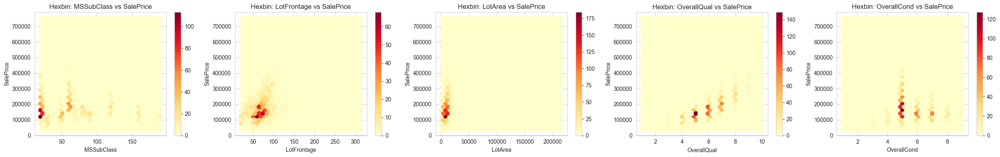

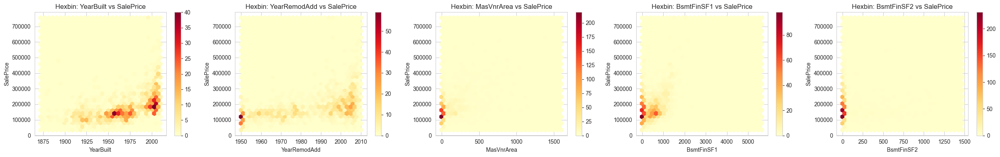

In [34]:
if 'SalePrice' in data.columns:
    sp_cols = [col for col in numeric_cols if col != 'SalePrice'][:10]
    for i in range(0, len(sp_cols), 5):
        batch = sp_cols[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            valid_mask = data[col].notna() & data['SalePrice'].notna()
            hb = axes[j].hexbin(data.loc[valid_mask, col], data.loc[valid_mask, 'SalePrice'], gridsize=30, cmap='YlOrRd')
            axes[j].set_title(f'Hexbin: {col} vs SalePrice')
            axes[j].set_xlabel(col)
            axes[j].set_ylabel('SalePrice')
            plt.colorbar(hb, ax=axes[j])
        plt.tight_layout()
        plt.show()

## 2D DENSITY PLOTS

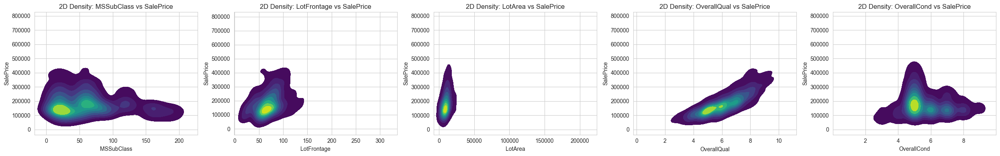

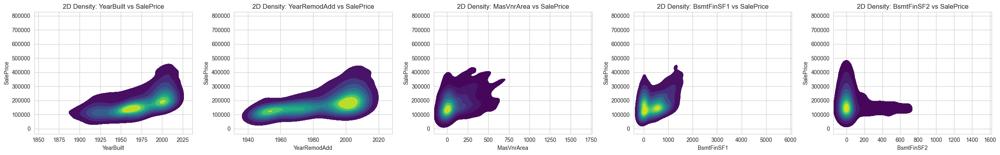

In [35]:
if 'SalePrice' in data.columns:
    sp_cols = [col for col in numeric_cols if col != 'SalePrice'][:10]
    for i in range(0, len(sp_cols), 5):
        batch = sp_cols[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            sns.kdeplot(data=data, x=col, y='SalePrice', fill=True, cmap='viridis', ax=axes[j])
            axes[j].set_title(f'2D Density: {col} vs SalePrice')
        plt.tight_layout()
        plt.show()

## HEATMAPS FOR CATEGORICAL COMBINATIONS

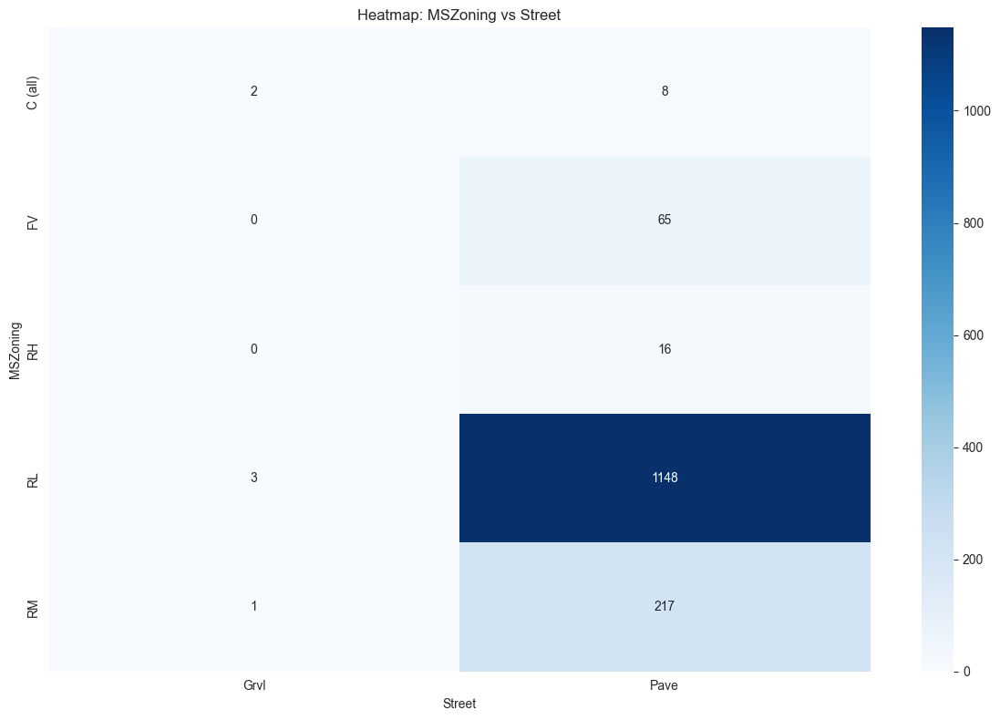

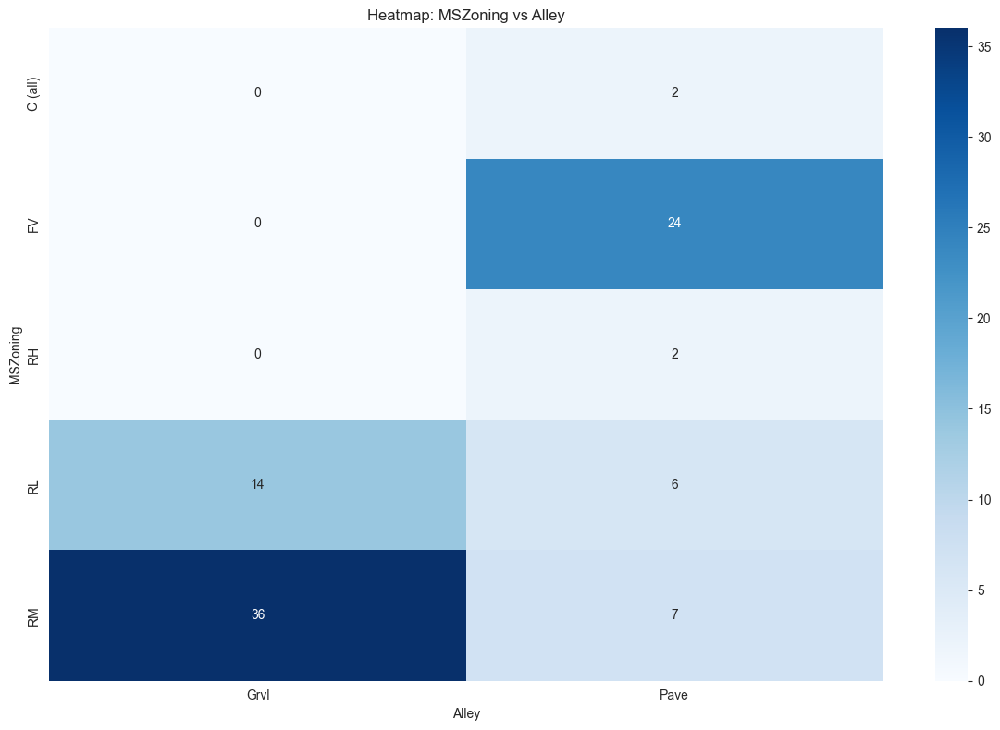

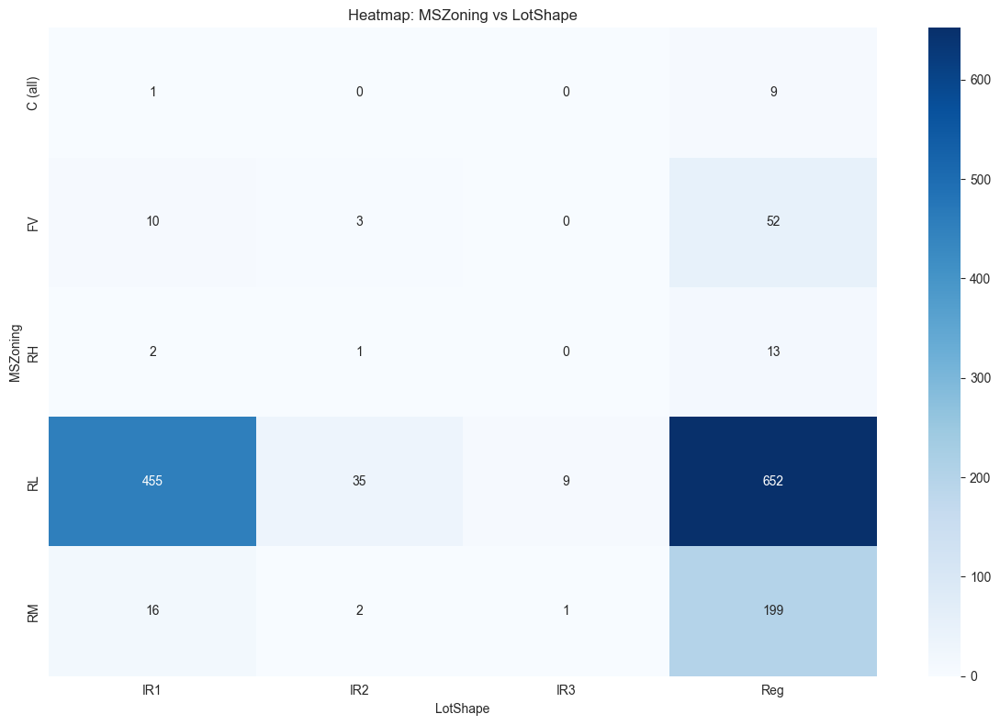

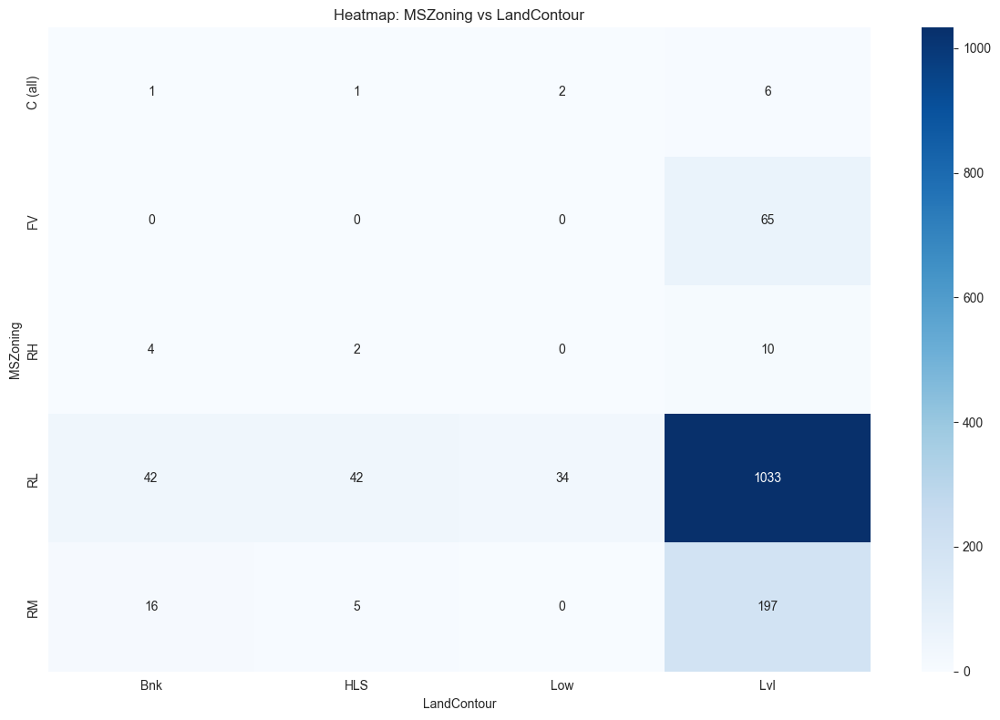

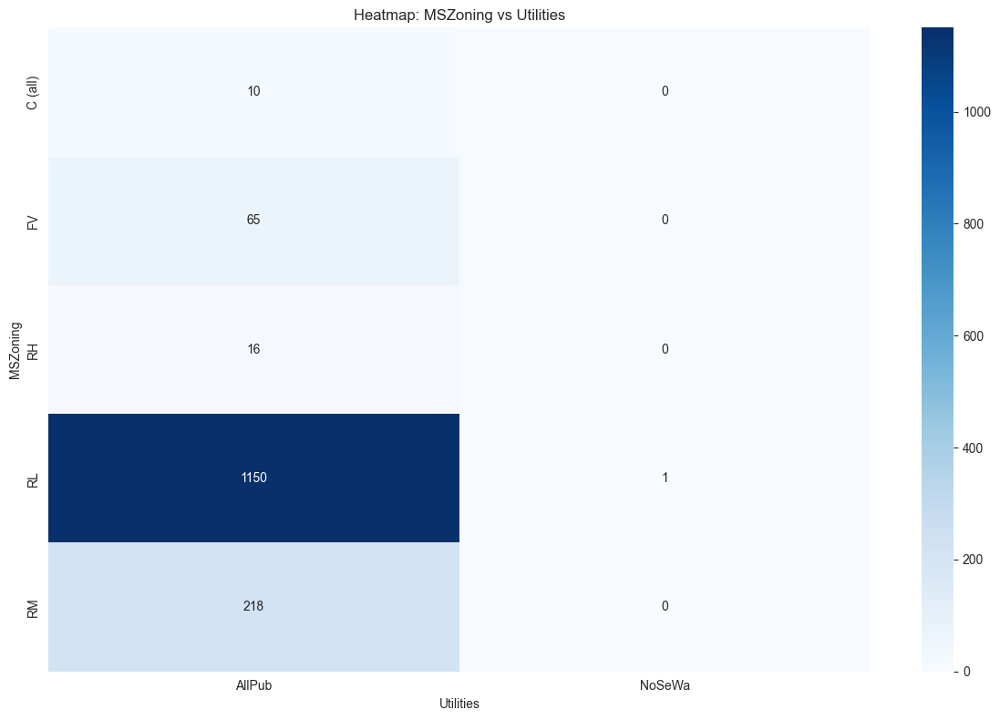

...

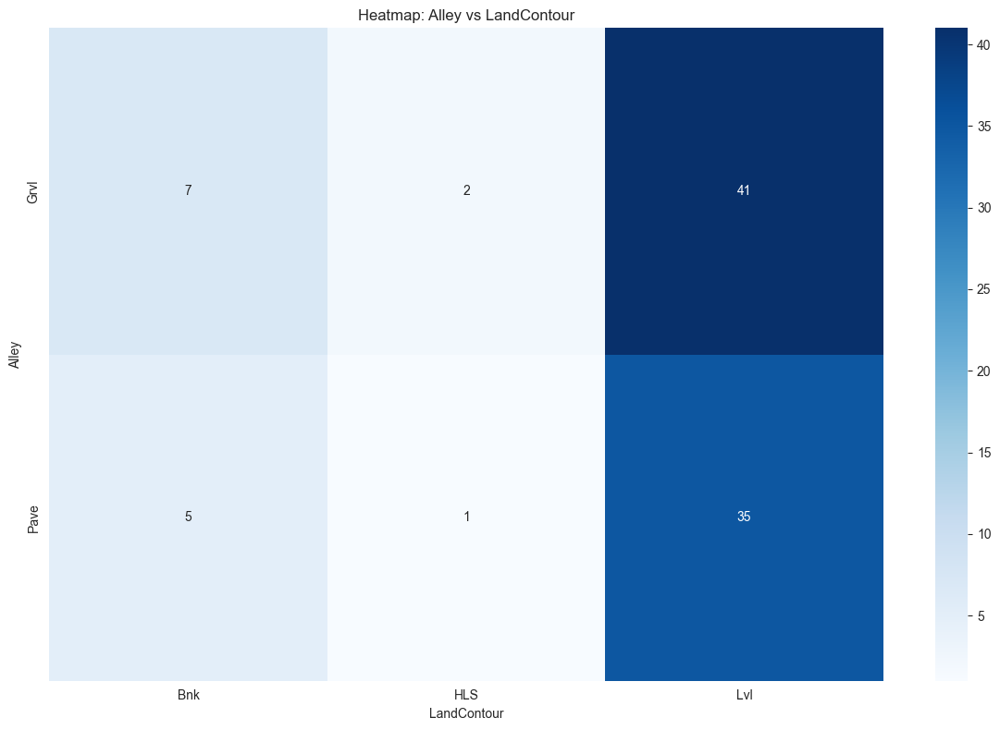

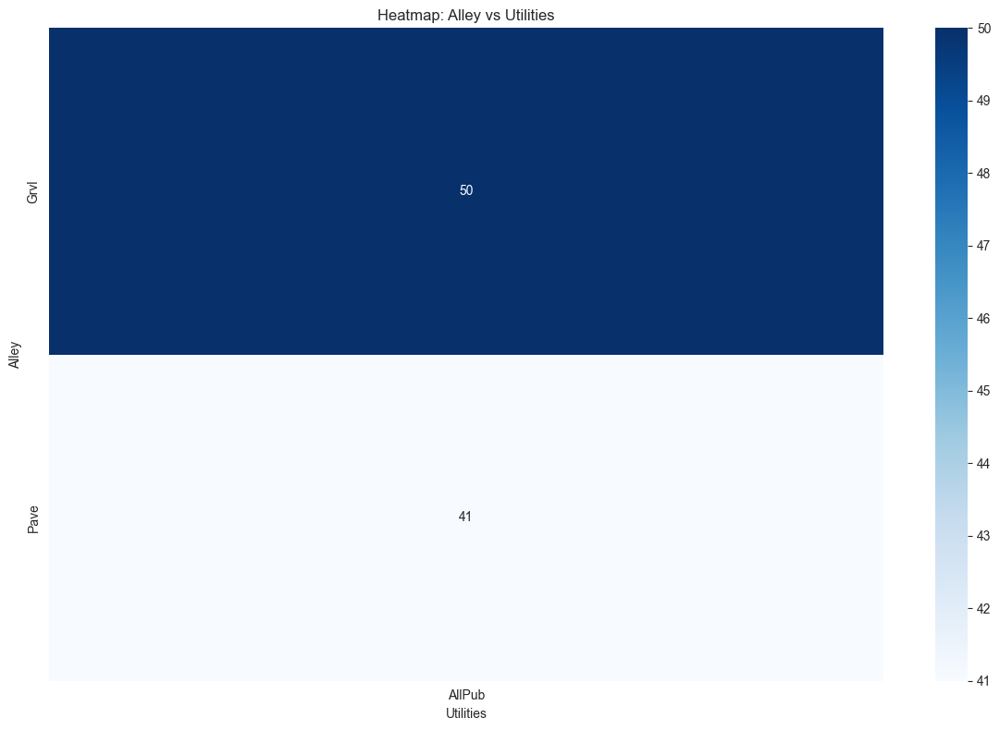

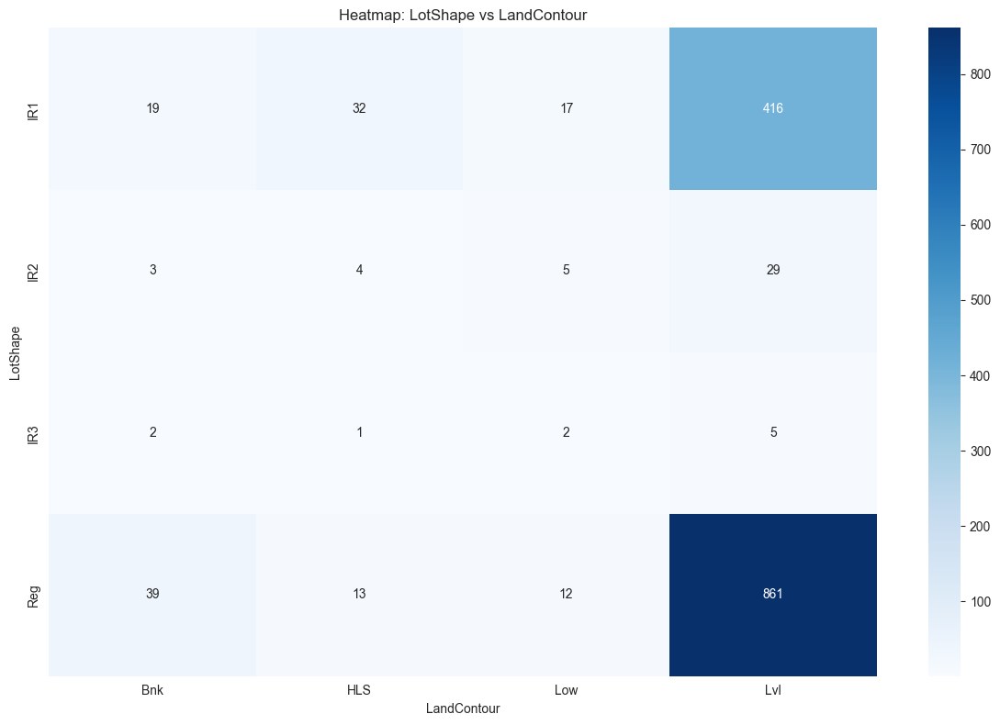

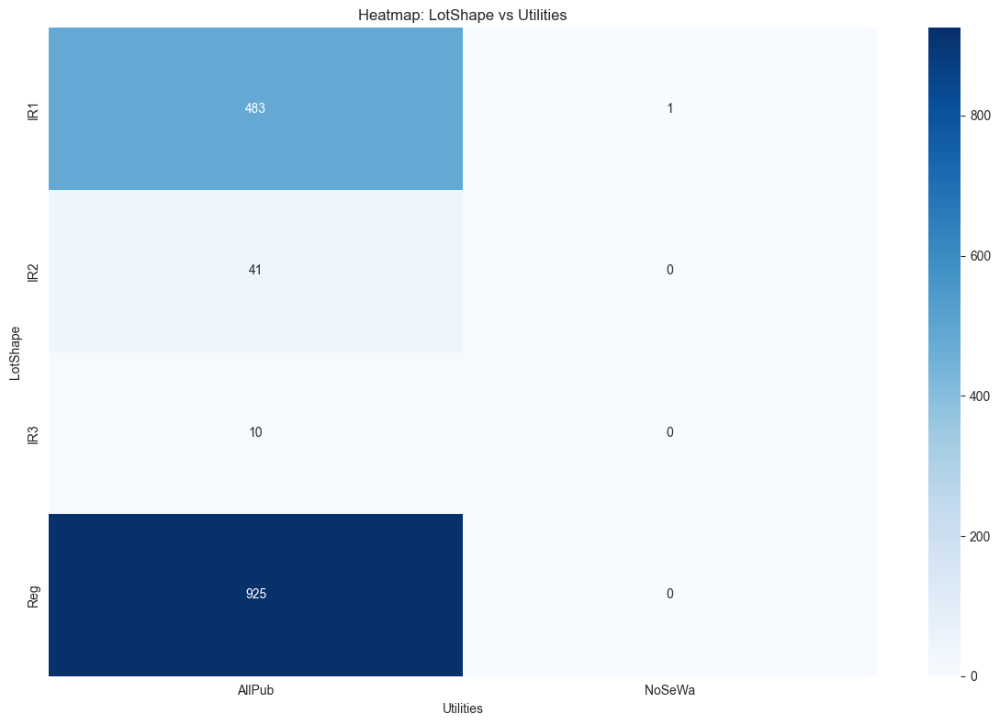

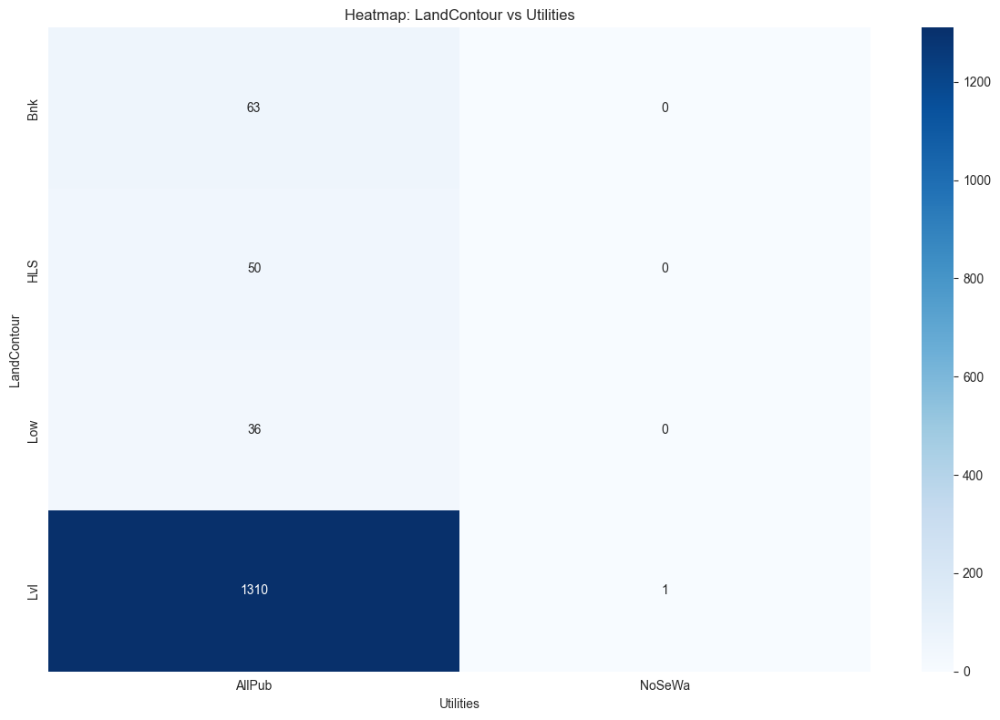

In [36]:
for i, col1 in enumerate(categorical_cols[:5]):
    for col2 in categorical_cols[i+1:6]:
        try:
            pivot = pd.crosstab(data[col1], data[col2])
            plt.figure(figsize=(12, 8))
            sns.heatmap(pivot, annot=True, fmt='d', cmap='Blues')
            plt.title(f'Heatmap: {col1} vs {col2}')
            plt.tight_layout()
            plt.show()
        except:
            pass

## STACKED BAR CHARTS

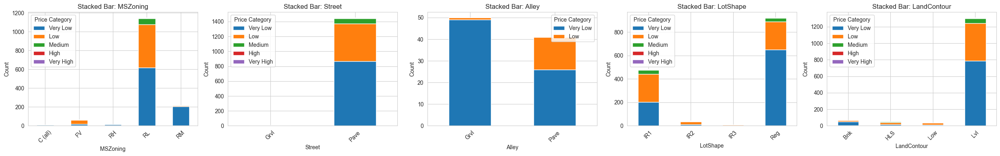

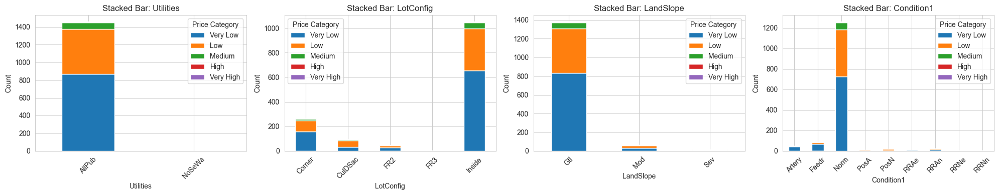

In [37]:
if 'SalePrice' in data.columns:
    data['PriceCategory'] = pd.cut(data['SalePrice'], bins=5, labels=['Very Low', 'Low', 'Medium', 'High', 'Very High'])
    
    stack_cols = [col for col in categorical_cols[:10] if data[col].nunique() <= 10]
    for i in range(0, len(stack_cols), 5):
        batch = stack_cols[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            pd.crosstab(data[col], data['PriceCategory']).plot(kind='bar', stacked=True, ax=axes[j])
            axes[j].set_title(f'Stacked Bar: {col}')
            axes[j].set_xlabel(col)
            axes[j].set_ylabel('Count')
            axes[j].legend(title='Price Category')
            axes[j].tick_params(axis='x', rotation=45)
        plt.tight_layout()
        plt.show()

## LINE PLOTS (Time series if applicable)

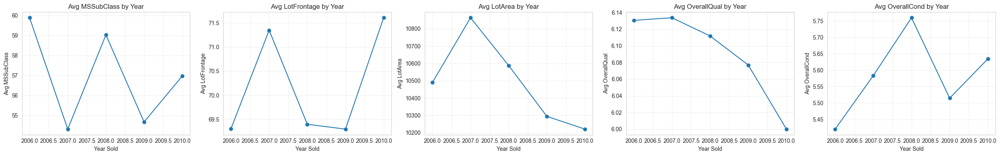

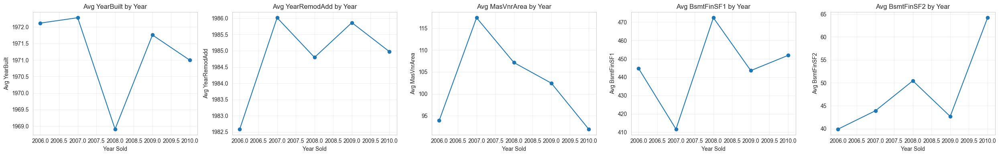

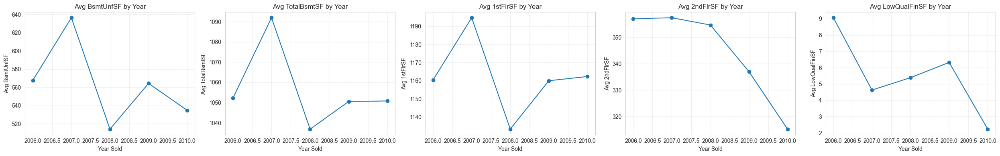

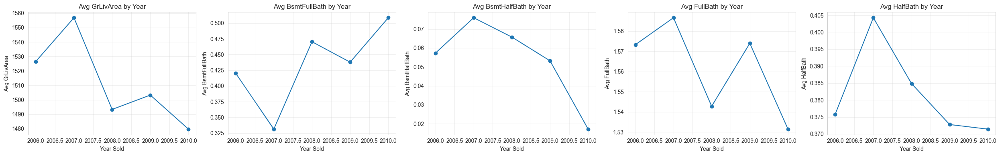

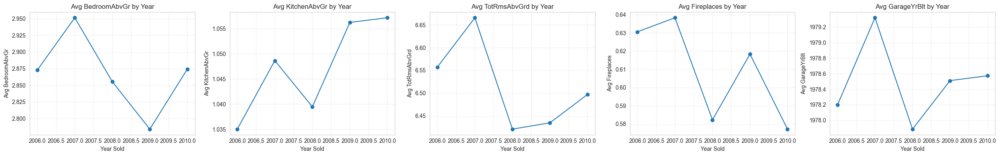

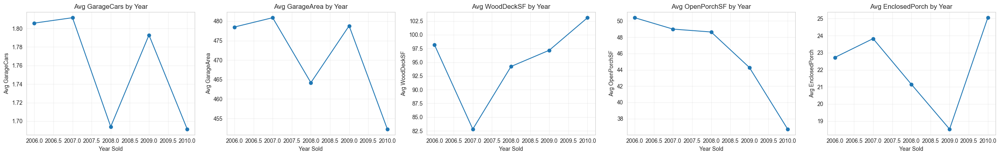

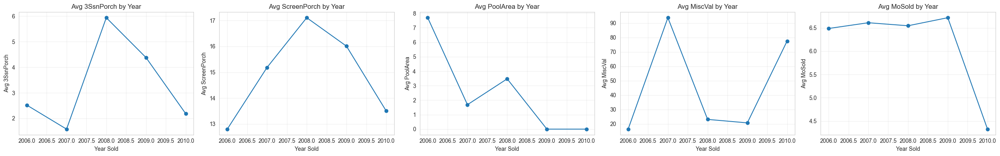

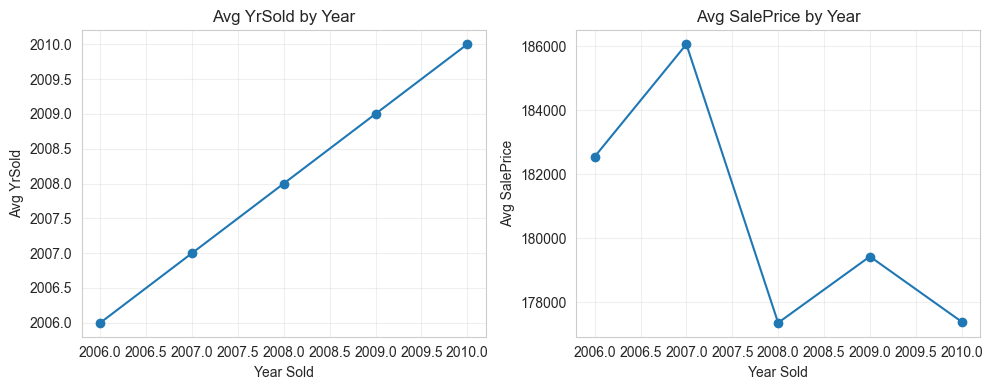

In [38]:
if 'YrSold' in data.columns:
    for i in range(0, len(numeric_cols), 5):
        batch = numeric_cols[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            data.groupby('YrSold')[col].mean().plot(marker='o', ax=axes[j])
            axes[j].set_title(f'Avg {col} by Year')
            axes[j].set_xlabel('Year Sold')
            axes[j].set_ylabel(f'Avg {col}')
            axes[j].grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()

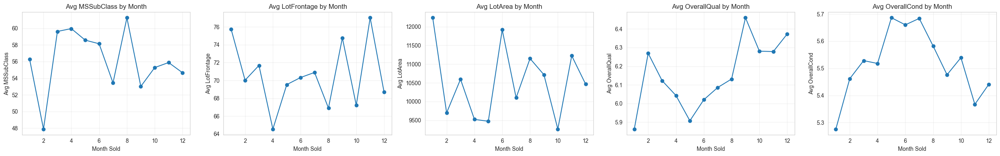

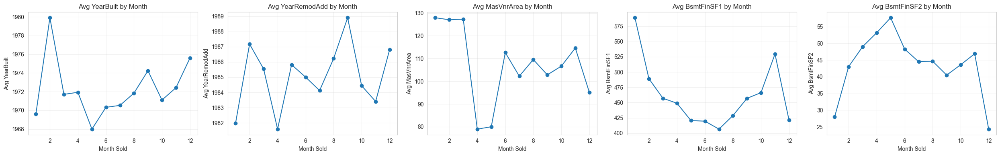

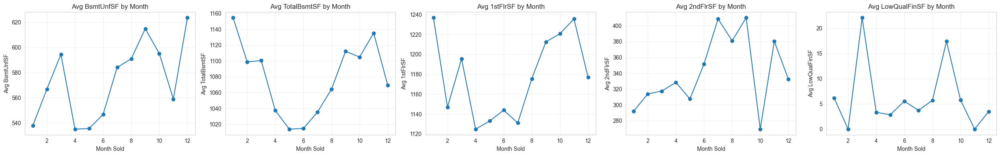

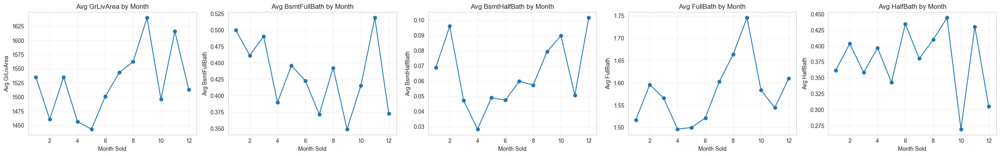

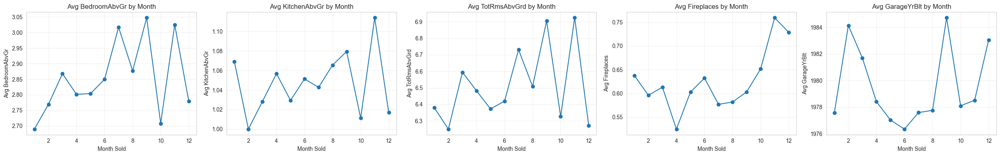

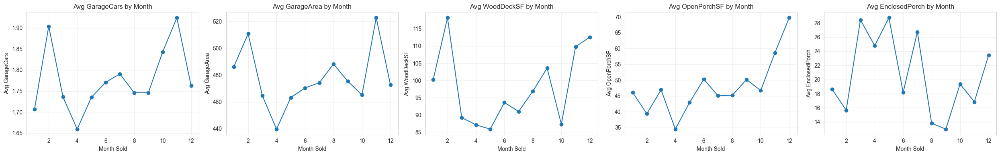

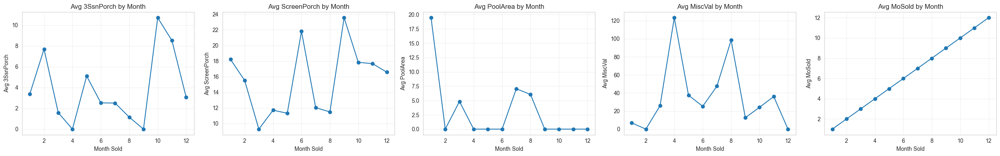

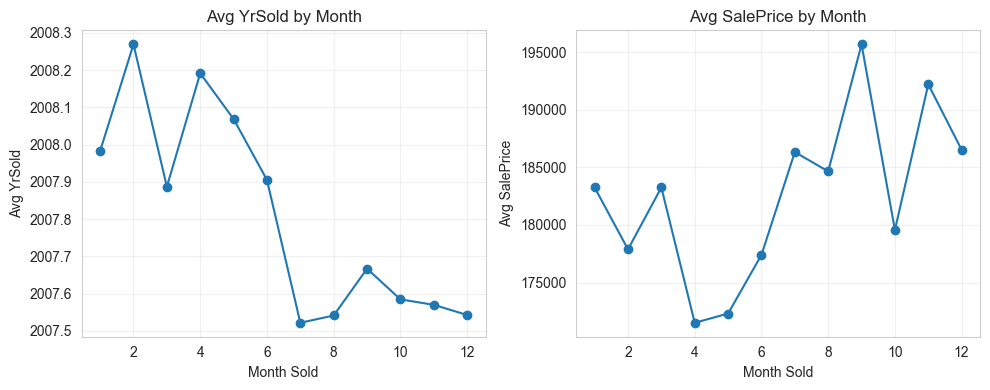

In [39]:
if 'MoSold' in data.columns:
    for i in range(0, len(numeric_cols), 5):
        batch = numeric_cols[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            data.groupby('MoSold')[col].mean().plot(marker='o', ax=axes[j])
            axes[j].set_title(f'Avg {col} by Month')
            axes[j].set_xlabel('Month Sold')
            axes[j].set_ylabel(f'Avg {col}')
            axes[j].grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()

## AREA PLOTS

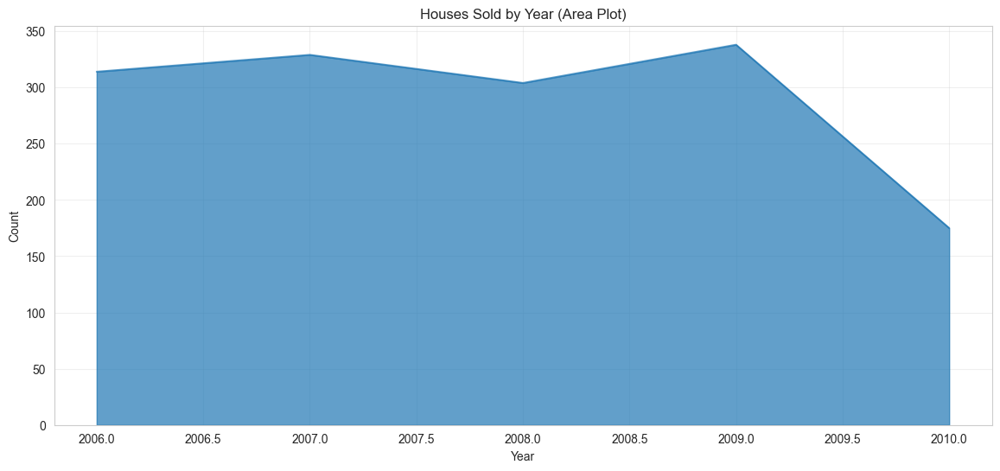

In [40]:
if 'YrSold' in data.columns:
    plt.figure(figsize=(14, 6))
    data.groupby('YrSold').size().plot(kind='area', alpha=0.7)
    plt.title('Houses Sold by Year (Area Plot)')
    plt.xlabel('Year')
    plt.ylabel('Count')
    plt.grid(True, alpha=0.3)
    plt.show()

## CLUSTERED BAR CHARTS

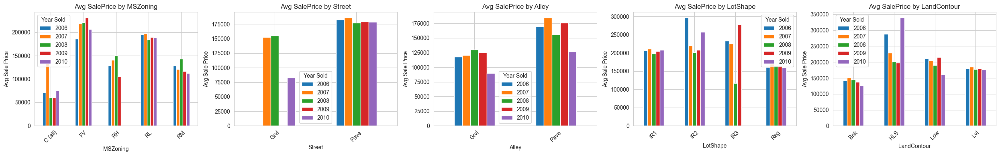

In [41]:
clust_cols = [col for col in categorical_cols[:5] if data[col].nunique() <= 10]
if 'SalePrice' in data.columns and 'YrSold' in data.columns:
    for i in range(0, len(clust_cols), 5):
        batch = clust_cols[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 4))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            data.groupby([col, 'YrSold'])['SalePrice'].mean().unstack().plot(kind='bar', ax=axes[j])
            axes[j].set_title(f'Avg SalePrice by {col}')
            axes[j].set_xlabel(col)
            axes[j].set_ylabel('Avg Sale Price')
            axes[j].legend(title='Year Sold')
            axes[j].tick_params(axis='x', rotation=45)
        plt.tight_layout()
        plt.show()

## FACET GRIDS

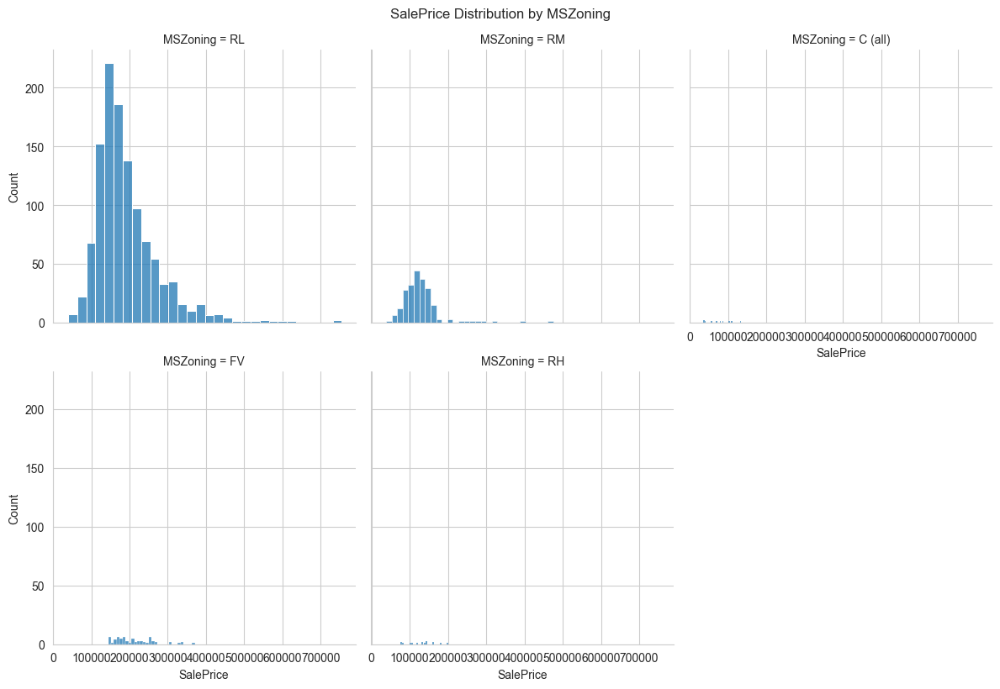

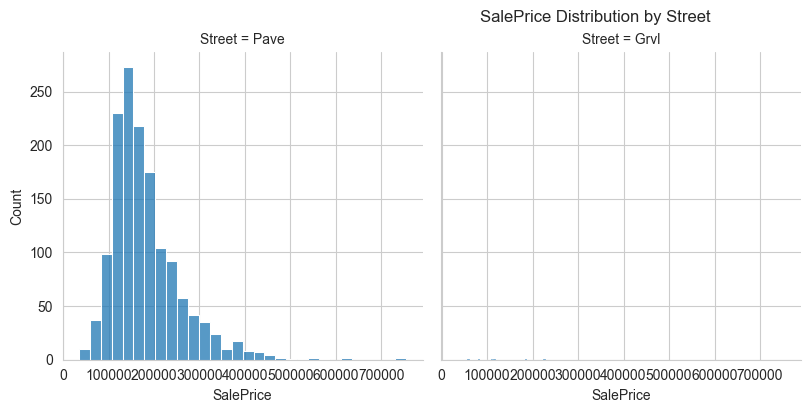

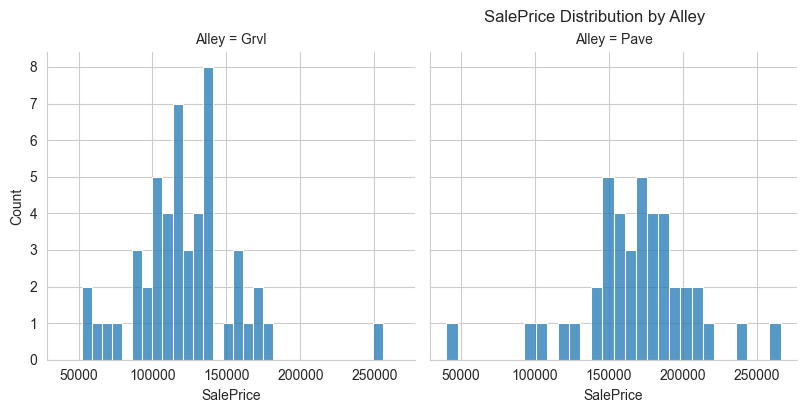

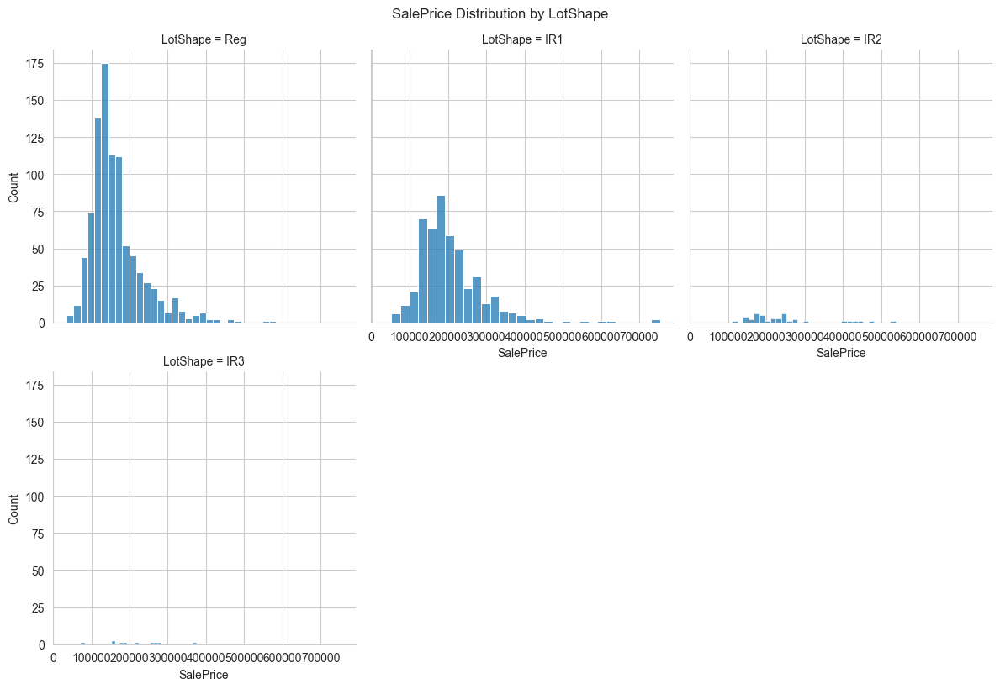

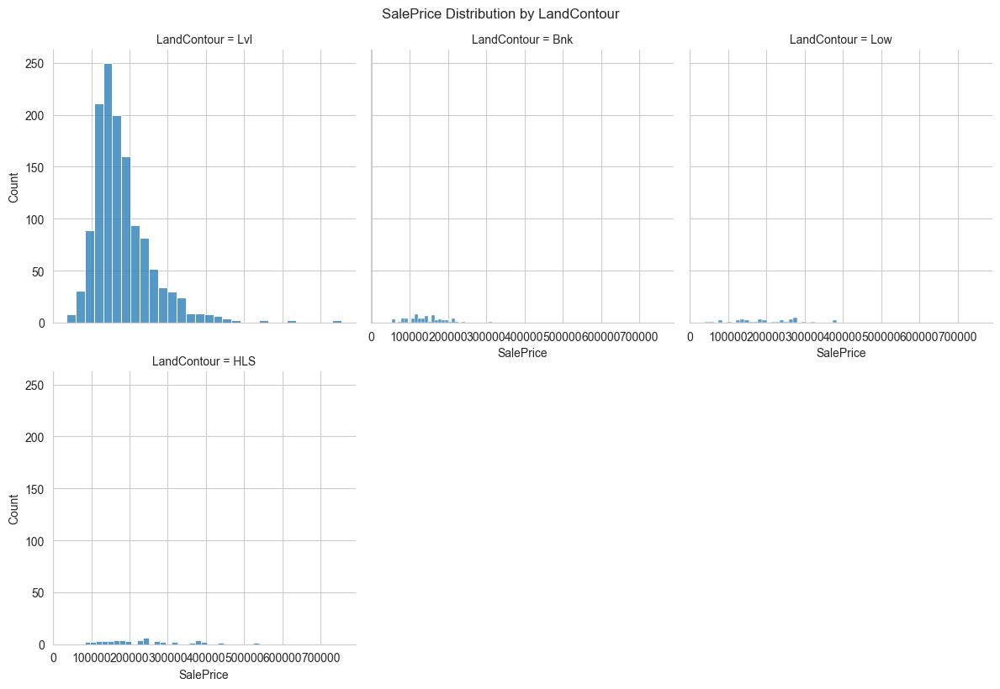

In [42]:
if 'SalePrice' in data.columns and len(categorical_cols) > 0:
    for col in categorical_cols[:5]:
        if data[col].nunique() <= 6:
            g = sns.FacetGrid(data, col=col, col_wrap=3, height=4)
            g.map(sns.histplot, 'SalePrice', bins=30)
            plt.suptitle(f'SalePrice Distribution by {col}', y=1.02)
            plt.show()

## RIDGELINE-STYLE PLOTS

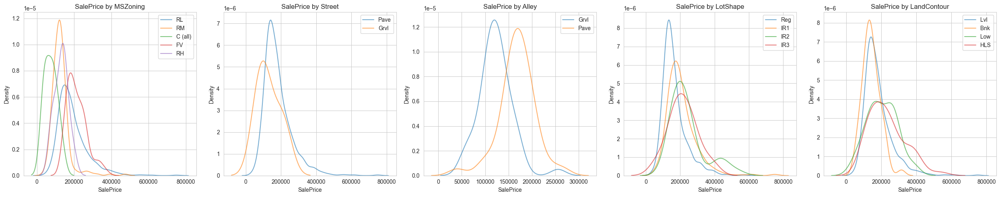

In [43]:
if 'SalePrice' in data.columns:
    ridge_cols = [col for col in categorical_cols[:5] if data[col].nunique() <= 8]
    for i in range(0, len(ridge_cols), 5):
        batch = ridge_cols[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 5))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            for category in data[col].unique():
                subset = data[data[col] == category]['SalePrice'].dropna()
                if len(subset) > 0:
                    sns.kdeplot(subset, label=category, alpha=0.6, ax=axes[j])
            axes[j].set_title(f'SalePrice by {col}')
            axes[j].set_xlabel('SalePrice')
            axes[j].set_ylabel('Density')
            axes[j].legend()
        plt.tight_layout()
        plt.show()

## BUBBLE CHARTS

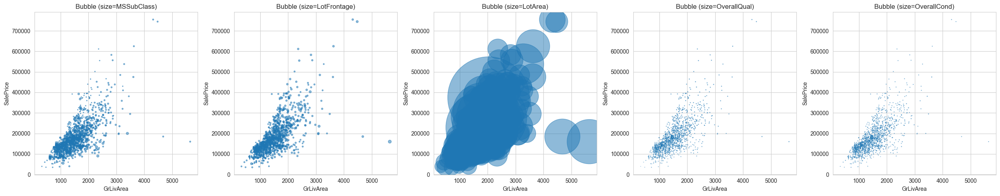

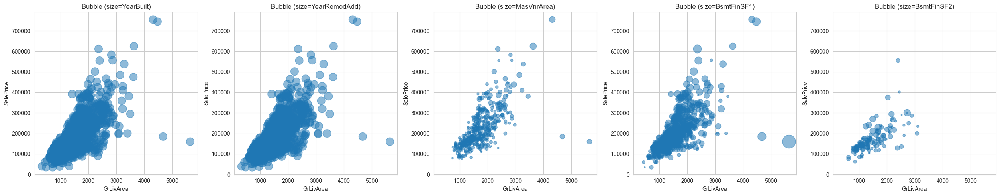

In [44]:
if 'SalePrice' in data.columns and 'GrLivArea' in data.columns:
    bubble_cols = [col for col in numeric_cols[:10] if col not in ['SalePrice', 'GrLivArea']]
    for i in range(0, len(bubble_cols), 5):
        batch = bubble_cols[i:i+5]
        fig, axes = plt.subplots(1, len(batch), figsize=(5*len(batch), 5))
        if len(batch) == 1:
            axes = [axes]
        for j, col in enumerate(batch):
            axes[j].scatter(data['GrLivArea'], data['SalePrice'], 
                       s=data[col].fillna(0)/10, alpha=0.5)
            axes[j].set_title(f'Bubble (size={col})')
            axes[j].set_xlabel('GrLivArea')
            axes[j].set_ylabel('SalePrice')
        plt.tight_layout()
        plt.show()

## ANDREWS CURVES

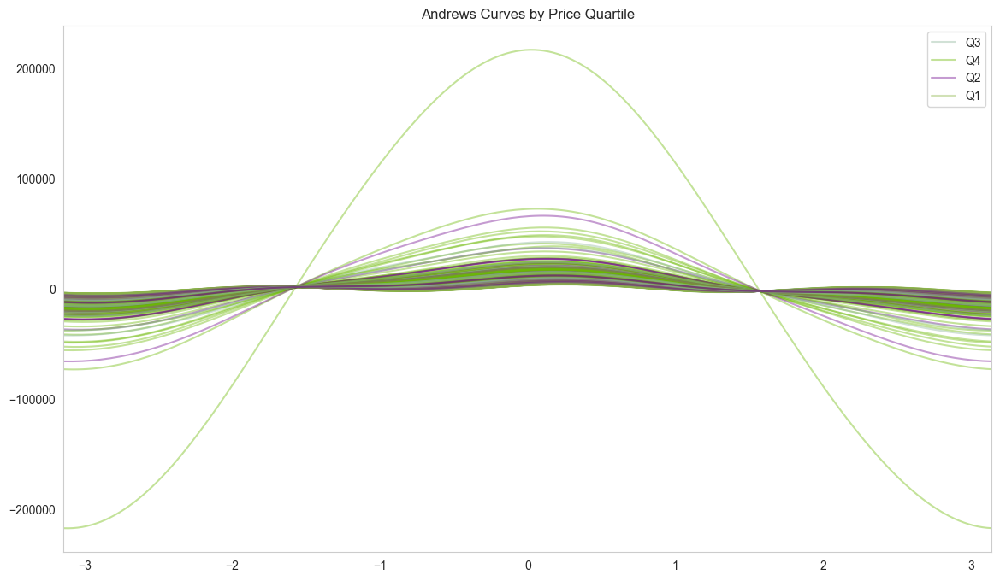

In [45]:
if 'SalePrice' in data.columns:
    data['PriceBin'] = pd.qcut(data['SalePrice'], q=4, labels=['Q1', 'Q2', 'Q3', 'Q4'])
    plt.figure(figsize=(14, 8))
    pd.plotting.andrews_curves(data[numeric_cols[:8] + ['PriceBin']], 'PriceBin', alpha=0.4)
    plt.title('Andrews Curves by Price Quartile')
    plt.legend(loc='best')
    plt.show()

## PARALLEL COORDINATES

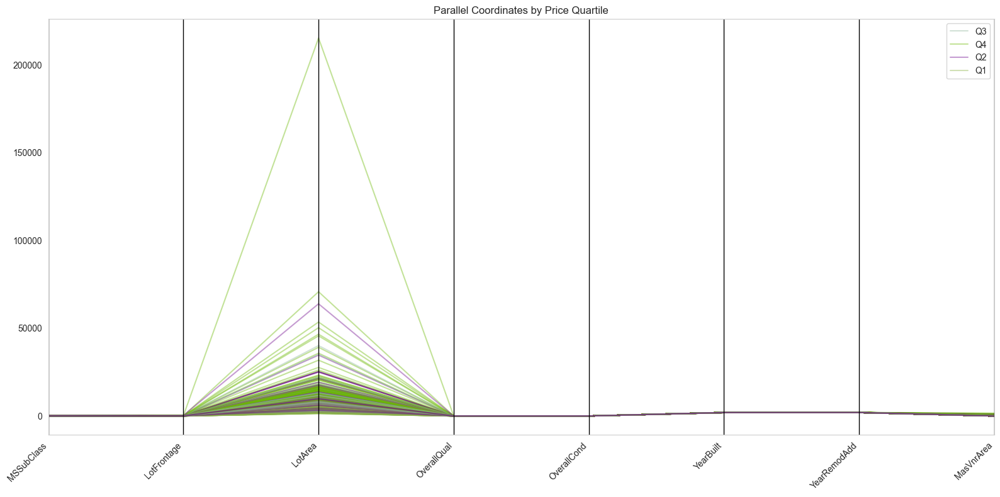

In [46]:
if 'SalePrice' in data.columns:
    plt.figure(figsize=(16, 8))
    pd.plotting.parallel_coordinates(
        data[numeric_cols[:8] + ['PriceBin']].dropna(), 
        'PriceBin', alpha=0.4
    )
    plt.title('Parallel Coordinates by Price Quartile')
    plt.legend(loc='best')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

## RADVIZ

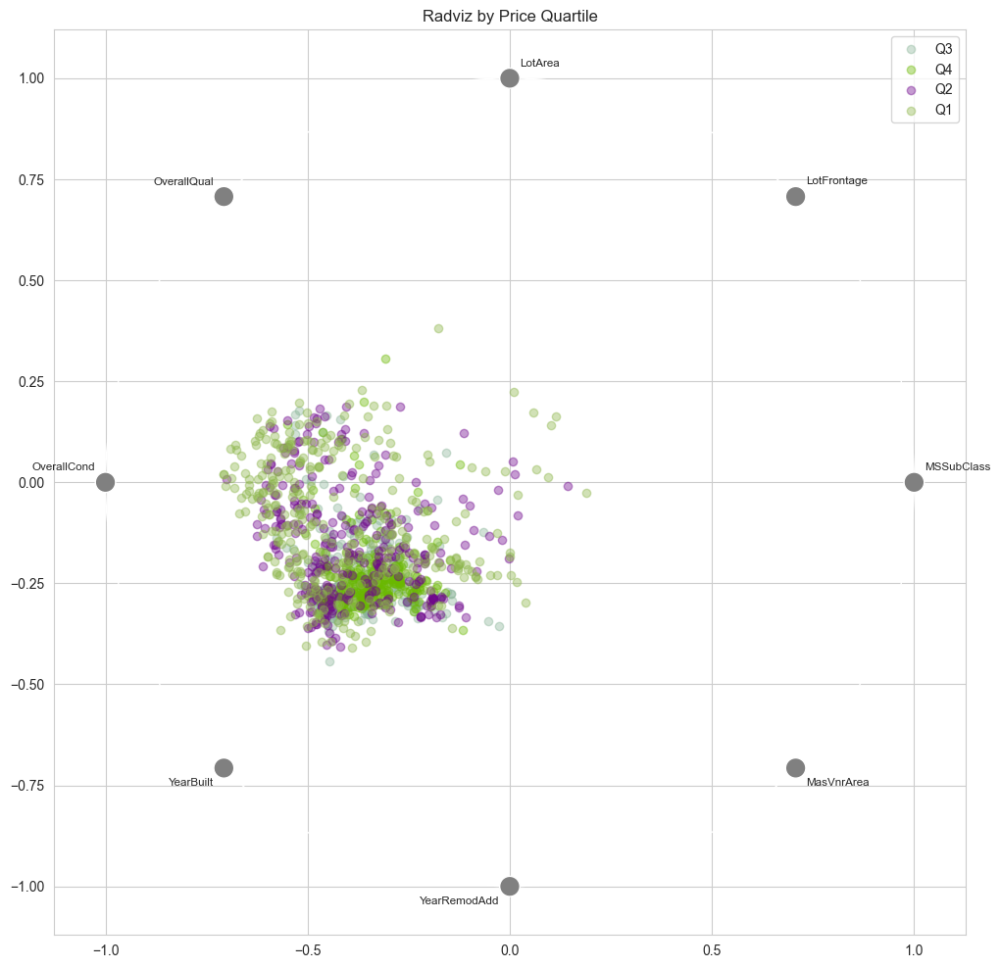

In [47]:
if 'SalePrice' in data.columns:
    plt.figure(figsize=(12, 12))
    pd.plotting.radviz(data[numeric_cols[:8] + ['PriceBin']].dropna(), 'PriceBin', alpha=0.4)
    plt.title('Radviz by Price Quartile')
    plt.show()

# Data Cleaning

In [8]:
data.shape

(1460, 81)

In [9]:
print(f"\nMemory Usage: {data.memory_usage(deep=True).sum() / 1024**2:.2f} MB")


Memory Usage: 3.86 MB


## MISSING VALUES ANALYSIS

In [10]:
missing_data = pd.DataFrame({
    'Column': data.columns,
    'Missing_Count': data.isnull().sum(),
    'Missing_Percentage': (data.isnull().sum() / len(data)) * 100,
    'Data_Type': data.dtypes
})
missing_data = missing_data[missing_data['Missing_Count'] > 0].sort_values('Missing_Percentage', ascending=False)
print("\nColumns with Missing Values:")
print(missing_data.to_string(index=False))


Columns with Missing Values:
      Column  Missing_Count  Missing_Percentage Data_Type
      PoolQC           1453           99.520548    object
 MiscFeature           1406           96.301370    object
       Alley           1369           93.767123    object
       Fence           1179           80.753425    object
  MasVnrType            872           59.726027    object
 FireplaceQu            690           47.260274    object
 LotFrontage            259           17.739726   float64
  GarageType             81            5.547945    object
 GarageYrBlt             81            5.547945   float64
GarageFinish             81            5.547945    object
  GarageQual             81            5.547945    object
  GarageCond             81            5.547945    object
BsmtExposure             38            2.602740    object
BsmtFinType2             38            2.602740    object
    BsmtQual             37            2.534247    object
    BsmtCond             37            2.5

<Figure size 1400x800 with 0 Axes>

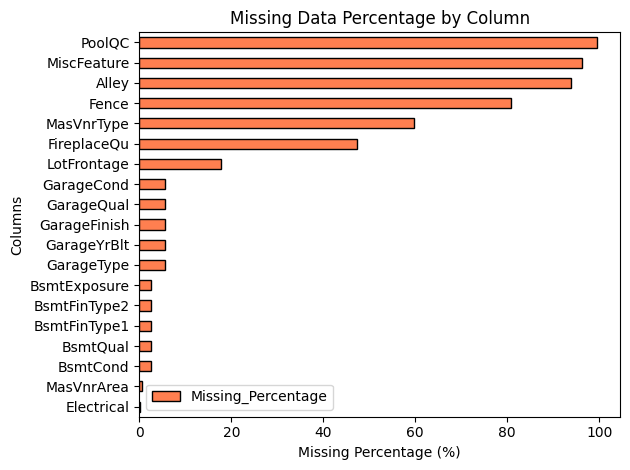

In [11]:
# Visualize missing data
plt.figure(figsize=(14, 8))
missing_data.sort_values('Missing_Percentage', ascending=True).plot(
    x='Column', y='Missing_Percentage', kind='barh', 
    color='coral', edgecolor='black'
)
plt.xlabel('Missing Percentage (%)')
plt.ylabel('Columns')
plt.title('Missing Data Percentage by Column')
plt.tight_layout()
plt.show()

## HANDLE MISSING VALUES

In [12]:
# Create a copy for cleaning
data_cleaned = data.copy()

In [13]:
# Strategy 1: Drop columns with > 50% missing data
high_missing_cols = missing_data[missing_data['Missing_Percentage'] > 50]['Column'].tolist()
print(f"\nDropping columns with >50% missing data: {high_missing_cols}")
data_cleaned = data_cleaned.drop(columns=high_missing_cols)


Dropping columns with >50% missing data: ['PoolQC', 'MiscFeature', 'Alley', 'Fence', 'MasVnrType']


In [14]:
# Strategy 2: Handle categorical variables
categorical_cols = data_cleaned.select_dtypes(include=['object']).columns

In [15]:
# For categorical with missing, fill with 'None' or mode
for col in categorical_cols:
    if data_cleaned[col].isnull().sum() > 0:
        # If missing means "absence of feature", fill with 'None'
        if col in ['Alley', 'MasVnrType', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 
                   'BsmtFinType1', 'BsmtFinType2', 'FireplaceQu', 'GarageType', 
                   'GarageFinish', 'GarageQual', 'GarageCond', 'Fence', 'MiscFeature']:
            data_cleaned[col].fillna('None', inplace=True)
            print(f"Filled '{col}' missing values with 'None'")
        else:
            # Fill with mode for other categorical
            mode_value = data_cleaned[col].mode()[0]
            data_cleaned[col].fillna(mode_value, inplace=True)
            print(f"Filled '{col}' missing values with mode: '{mode_value}'")

Filled 'BsmtQual' missing values with 'None'
Filled 'BsmtCond' missing values with 'None'
Filled 'BsmtExposure' missing values with 'None'
Filled 'BsmtFinType1' missing values with 'None'
Filled 'BsmtFinType2' missing values with 'None'
Filled 'Electrical' missing values with mode: 'SBrkr'
Filled 'FireplaceQu' missing values with 'None'
Filled 'GarageType' missing values with 'None'
Filled 'GarageFinish' missing values with 'None'
Filled 'GarageQual' missing values with 'None'
Filled 'GarageCond' missing values with 'None'


In [16]:
# Strategy 3: Handle numeric variables
numeric_cols = data_cleaned.select_dtypes(include=[np.number]).columns.tolist()
if 'Id' in numeric_cols:
    numeric_cols.remove('Id')

for col in numeric_cols:
    if data_cleaned[col].isnull().sum() > 0:
        # Special handling for specific columns
        if col == 'LotFrontage':
            # Fill LotFrontage with median by Neighborhood
            data_cleaned['LotFrontage'] = data_cleaned.groupby('Neighborhood')['LotFrontage'].transform(
                lambda x: x.fillna(x.median())
            )
            print(f"Filled '{col}' with median by Neighborhood")
        elif col in ['GarageYrBlt']:
            # Fill with YearBuilt for garage year
            data_cleaned[col].fillna(data_cleaned['YearBuilt'], inplace=True)
            print(f"Filled '{col}' with YearBuilt")
        elif col in ['MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF']:
            # Fill area features with 0
            data_cleaned[col].fillna(0, inplace=True)
            print(f"Filled '{col}' with 0")
        else:
            # Fill with median for other numeric
            median_value = data_cleaned[col].median()
            data_cleaned[col].fillna(median_value, inplace=True)
            print(f"Filled '{col}' with median: {median_value:.2f}")

Filled 'LotFrontage' with median by Neighborhood
Filled 'MasVnrArea' with 0
Filled 'GarageYrBlt' with YearBuilt


In [17]:
data_cleaned.isnull().sum().sum()

np.int64(0)

## OUTLIER DETECTION AND TREATMENT

In [18]:
def detect_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    return len(outliers), lower_bound, upper_bound

In [19]:
def detect_outliers_zscore(df, column, threshold=3):
    z_scores = np.abs(stats.zscore(df[column].dropna()))
    outliers = np.sum(z_scores > threshold)
    return outliers

In [20]:
# Detect outliers in numeric columns
outlier_summary = []
for col in numeric_cols:
    if col != 'Id':
        iqr_count, lower, upper = detect_outliers_iqr(data_cleaned, col)
        z_count = detect_outliers_zscore(data_cleaned, col)
        outlier_summary.append({
            'Column': col,
            'IQR_Outliers': iqr_count,
            'ZScore_Outliers': z_count,
            'Lower_Bound': lower,
            'Upper_Bound': upper
        })

In [21]:
outlier_df = pd.DataFrame(outlier_summary)
outlier_df = outlier_df[outlier_df['IQR_Outliers'] > 0].sort_values('IQR_Outliers', ascending=False)
print("\nOutliers detected (IQR method):")
print(outlier_df.to_string(index=False))


Outliers detected (IQR method):
       Column  IQR_Outliers  ZScore_Outliers  Lower_Bound  Upper_Bound
EnclosedPorch           208               51        0.000        0.000
   BsmtFinSF2           167               50        0.000        0.000
  OverallCond           125               28        3.500        7.500
  ScreenPorch           116               55        0.000        0.000
   MSSubClass           103               30      -55.000      145.000
   MasVnrArea            98               32     -246.375      410.625
  LotFrontage            93               15       30.000      110.000
 BsmtHalfBath            82               82        0.000        0.000
  OpenPorchSF            77               27     -102.000      170.000
      LotArea            69               13     1481.500    17673.500
 KitchenAbvGr            68               68        1.000        1.000
    SalePrice            61               22     3937.500   340037.500
  TotalBsmtSF            61               10

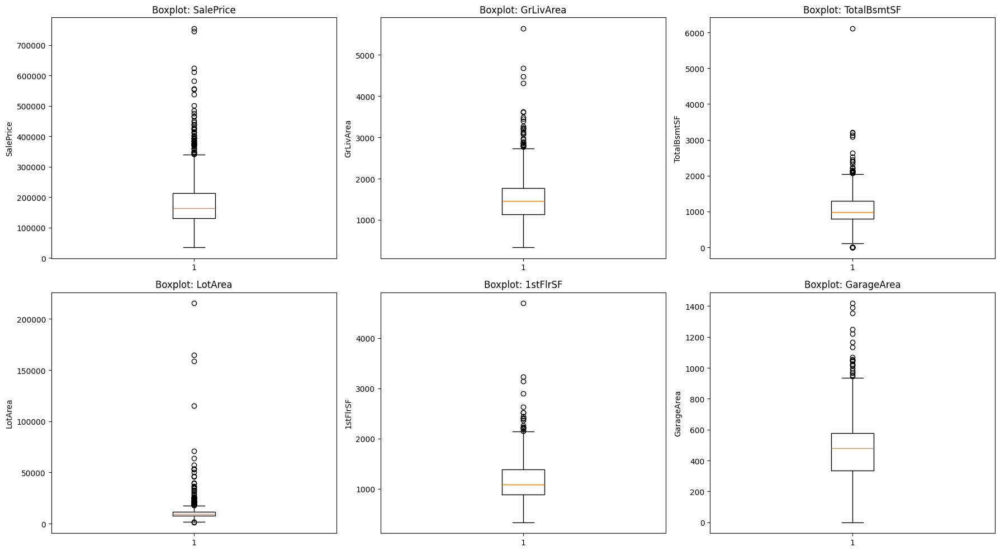

In [22]:
# Visualize outliers for key columns
if 'SalePrice' in data_cleaned.columns:
    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    axes = axes.flatten()
    
    key_cols = ['SalePrice', 'GrLivArea', 'TotalBsmtSF', 'LotArea', '1stFlrSF', 'GarageArea']
    for i, col in enumerate(key_cols):
        if col in data_cleaned.columns:
            axes[i].boxplot(data_cleaned[col].dropna())
            axes[i].set_title(f'Boxplot: {col}')
            axes[i].set_ylabel(col)
    
    plt.tight_layout()
    plt.show()

In [24]:
# Treatment: Cap extreme outliers (optional - uncomment if needed)
for col in numeric_cols:
    if col not in ['Id', 'YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold', 'MoSold']:
        Q1 = data_cleaned[col].quantile(0.01)
        Q3 = data_cleaned[col].quantile(0.99)
        data_cleaned[col] = data_cleaned[col].clip(lower=Q1, upper=Q3)

## DATA TYPE CONVERSION

In [25]:
# Convert year columns to proper format
year_cols = ['YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold']
for col in year_cols:
    if col in data_cleaned.columns:
        data_cleaned[col] = data_cleaned[col].astype('int64')
        print(f"Converted '{col}' to int64")

Converted 'YearBuilt' to int64
Converted 'YearRemodAdd' to int64
Converted 'GarageYrBlt' to int64
Converted 'YrSold' to int64


In [26]:
# Convert month to categorical
if 'MoSold' in data_cleaned.columns:
    data_cleaned['MoSold'] = data_cleaned['MoSold'].astype('category')
    print("Converted 'MoSold' to category")

Converted 'MoSold' to category


In [27]:
# Convert ordinal quality columns to ordered categories
quality_cols = ['ExterQual', 'ExterCond', 'BsmtQual', 'BsmtCond', 'HeatingQC', 
                'KitchenQual', 'FireplaceQu', 'GarageQual', 'GarageCond']
quality_order = ['None', 'Po', 'Fa', 'TA', 'Gd', 'Ex']

for col in quality_cols:
    if col in data_cleaned.columns:
        data_cleaned[col] = pd.Categorical(data_cleaned[col], categories=quality_order, ordered=True)
        print(f"Converted '{col}' to ordered category")

Converted 'ExterQual' to ordered category
Converted 'ExterCond' to ordered category
Converted 'BsmtQual' to ordered category
Converted 'BsmtCond' to ordered category
Converted 'HeatingQC' to ordered category
Converted 'KitchenQual' to ordered category
Converted 'FireplaceQu' to ordered category
Converted 'GarageQual' to ordered category
Converted 'GarageCond' to ordered category


In [28]:
# Convert other categorical columns
other_cat_cols = [col for col in categorical_cols if col not in quality_cols]
for col in other_cat_cols:
    if col in data_cleaned.columns:
        data_cleaned[col] = data_cleaned[col].astype('category')
        print(f"Converted '{col}' to category")

Converted 'MSZoning' to category
Converted 'Street' to category
Converted 'LotShape' to category
Converted 'LandContour' to category
Converted 'Utilities' to category
Converted 'LotConfig' to category
Converted 'LandSlope' to category
Converted 'Neighborhood' to category
Converted 'Condition1' to category
Converted 'Condition2' to category
Converted 'BldgType' to category
Converted 'HouseStyle' to category
Converted 'RoofStyle' to category
Converted 'RoofMatl' to category
Converted 'Exterior1st' to category
Converted 'Exterior2nd' to category
Converted 'Foundation' to category
Converted 'BsmtExposure' to category
Converted 'BsmtFinType1' to category
Converted 'BsmtFinType2' to category
Converted 'Heating' to category
Converted 'CentralAir' to category
Converted 'Electrical' to category
Converted 'Functional' to category
Converted 'GarageType' to category
Converted 'GarageFinish' to category
Converted 'PavedDrive' to category
Converted 'SaleType' to category
Converted 'SaleCondition' to

## DATA QUALITY CHECKS

In [29]:
# Check for duplicates
duplicates = data_cleaned.duplicated().sum()
print(f"\nDuplicate rows: {duplicates}")
if duplicates > 0:
    data_cleaned = data_cleaned.drop_duplicates()
    print(f"Removed {duplicates} duplicate rows")


Duplicate rows: 0


In [30]:
# Check for negative values in area/size columns
area_cols = ['LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 
             'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'GarageArea']

print("\nChecking for negative values in area columns:")
for col in area_cols:
    if col in data_cleaned.columns:
        neg_count = (data_cleaned[col] < 0).sum()
        if neg_count > 0:
            print(f"  {col}: {neg_count} negative values found")
            data_cleaned[col] = data_cleaned[col].abs()
        else:
            print(f"  {col}: OK")


Checking for negative values in area columns:
  LotArea: OK
  MasVnrArea: OK
  BsmtFinSF1: OK
  BsmtFinSF2: OK
  BsmtUnfSF: OK
  TotalBsmtSF: OK
  1stFlrSF: OK
  2ndFlrSF: OK
  GrLivArea: OK
  GarageArea: OK


In [31]:
# 1stFlrSF + 2ndFlrSF should roughly equal GrLivArea
if all(col in data_cleaned.columns for col in ['1stFlrSF', '2ndFlrSF', 'GrLivArea']):
    total_floor = data_cleaned['1stFlrSF'] + data_cleaned['2ndFlrSF']
    inconsistent = abs(total_floor - data_cleaned['GrLivArea']) > 100
    print(f"  Floor area inconsistencies: {inconsistent.sum()} rows")

  Floor area inconsistencies: 44 rows


In [32]:
# YearRemodAdd should be >= YearBuilt
if all(col in data_cleaned.columns for col in ['YearBuilt', 'YearRemodAdd']):
    invalid_years = data_cleaned['YearRemodAdd'] < data_cleaned['YearBuilt']
    print(f"  Invalid remodel years: {invalid_years.sum()} rows")
    if invalid_years.sum() > 0:
        data_cleaned.loc[invalid_years, 'YearRemodAdd'] = data_cleaned.loc[invalid_years, 'YearBuilt']

  Invalid remodel years: 0 rows


# Feature Engineering

In [33]:
df = data_cleaned.copy()

## Date/Time Features

In [35]:
if 'YrSold' in df.columns and 'MoSold' in df.columns:
    season_map = {12: 'Winter', 1: 'Winter', 2: 'Winter',
                  3: 'Spring', 4: 'Spring', 5: 'Spring',
                  6: 'Summer', 7: 'Summer', 8: 'Summer',
                  9: 'Fall', 10: 'Fall', 11: 'Fall'}
    df['Season'] = df['MoSold'].map(season_map)
    df['IsPeakSeason'] = df['Season'].isin(['Spring', 'Summer']).astype(int)
    print("Created Season and IsPeakSeason features")

Created Season and IsPeakSeason features


## Interaction Features

In [36]:
if 'GrLivArea' in df.columns and 'OverallQual' in df.columns:
    df['QualityArea'] = df['GrLivArea'] * df['OverallQual']
    print("Created QualityArea interaction")

Created QualityArea interaction


In [37]:
if 'TotalBsmtSF' in df.columns and 'GrLivArea' in df.columns:
    df['BsmtRatio'] = df['TotalBsmtSF'] / (df['GrLivArea'] + 1)
    print("Created BsmtRatio feature")

Created BsmtRatio feature


In [38]:
if 'GarageArea' in df.columns and 'GrLivArea' in df.columns:
    df['GarageRatio'] = df['GarageArea'] / (df['GrLivArea'] + 1)
    print("Created GarageRatio feature")

Created GarageRatio feature


In [39]:
if 'LotArea' in df.columns and 'GrLivArea' in df.columns:
    df['LotAreaRatio'] = df['GrLivArea'] / (df['LotArea'] + 1)
    print("Created LotAreaRatio feature")

Created LotAreaRatio feature


## Polynomial Features

In [40]:
if 'OverallQual' in df.columns:
    df['OverallQual_Squared'] = df['OverallQual'] ** 2
    df['OverallQual_Cubed'] = df['OverallQual'] ** 3
    print("Created polynomial features for OverallQual")

Created polynomial features for OverallQual


In [41]:
if 'GrLivArea' in df.columns:
    df['GrLivArea_Squared'] = df['GrLivArea'] ** 2
    print("Created GrLivArea_Squared feature")

Created GrLivArea_Squared feature


## Aggregation Features

In [42]:
if 'Neighborhood' in df.columns and 'SalePrice' in df.columns:
    df['Neighborhood_MeanPrice'] = df.groupby('Neighborhood')['SalePrice'].transform('mean')
    df['Neighborhood_MedianPrice'] = df.groupby('Neighborhood')['SalePrice'].transform('median')
    df['Neighborhood_StdPrice'] = df.groupby('Neighborhood')['SalePrice'].transform('std')
    print("Created neighborhood aggregation features")

Created neighborhood aggregation features


In [43]:
if 'MSSubClass' in df.columns and 'SalePrice' in df.columns:
    df['MSSubClass_MeanPrice'] = df.groupby('MSSubClass')['SalePrice'].transform('mean')
    print("Created MSSubClass aggregation features")

Created MSSubClass aggregation features


## Domain-Specific Features

In [44]:
quality_features = ['OverallQual', 'OverallCond']
if all(col in df.columns for col in quality_features):
    df['QualityScore'] = df[quality_features].mean(axis=1)
    print("Created QualityScore feature")

Created QualityScore feature


In [45]:
if all(col in df.columns for col in ['TotRmsAbvGrd', 'BedroomAbvGr']):
    df['NonBedroomRooms'] = df['TotRmsAbvGrd'] - df['BedroomAbvGr']
    print("Created NonBedroomRooms feature")

Created NonBedroomRooms feature


In [46]:
if 'OverallCond' in df.columns and 'HouseAge' in df.columns:
    df['ConditionAgeRatio'] = df['OverallCond'] / (df['HouseAge'] + 1)
    print("Created ConditionAgeRatio feature")

In [47]:
# Total rooms count
room_cols = ['FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd']
if all(col in df.columns for col in room_cols):
    df['TotalRooms'] = df[room_cols].sum(axis=1)
    print("Created TotalRooms feature")


Created TotalRooms feature


In [48]:
# Remodel indicator
if 'YearBuilt' in df.columns and 'YearRemodAdd' in df.columns:
    df['IsRemodeled'] = (df['YearRemodAdd'] != df['YearBuilt']).astype(int)
    print("Created IsRemodeled feature")


Created IsRemodeled feature


# Feature Encoding

In [49]:
df.shape[1]

93

In [50]:
df.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrArea', 'ExterQual',
       'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF',
       'TotalBsmtSF', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical',
       '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath',
       'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr',
       'KitchenQual', 'TotRmsAbvGrd', 'Functional', 'Fireplaces',
       'FireplaceQu', 'GarageType', 'GarageYrBlt', 'GarageFinish',
       'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond', 'PavedDrive',
       'WoodDeckSF', 'OpenP

In [51]:
# Separate target variable
target = 'SalePrice'
if target in df.columns:
    y = df[target].copy()
    X = df.drop(columns=[target])
    print(f"Separated target variable: {target}")
else:
    X = df.copy()
    y = None
    print("No target variable found, encoding all features")

Separated target variable: SalePrice


In [52]:
# Identify column types
numeric_cols = X.select_dtypes(include=[np.number]).columns.tolist()
if 'Id' in numeric_cols:
    numeric_cols.remove('Id')
    X = X.drop(columns=['Id'])

In [53]:
categorical_cols = X.select_dtypes(include=['object', 'category']).columns.tolist()

In [54]:
print(f"Numeric features: {len(numeric_cols)}")
print(f"Categorical features: {len(categorical_cols)}")

Numeric features: 51
Categorical features: 40


## Ordinal Encoding for ordered categories

In [55]:
ordinal_features = {
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'BsmtQual': ['None', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'BsmtCond': ['None', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'HeatingQC': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'FireplaceQu': ['None', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'GarageQual': ['None', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'GarageCond': ['None', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
    'BsmtExposure': ['None', 'No', 'Mn', 'Av', 'Gd'],
    'BsmtFinType1': ['None', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],
    'BsmtFinType2': ['None', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],
    'GarageFinish': ['None', 'Unf', 'RFn', 'Fin'],
}

In [56]:
X_encoded = X.copy()

In [57]:
for col, order in ordinal_features.items():
    if col in X_encoded.columns:
        X_encoded[col] = X_encoded[col].astype(str)
        mapping = {val: idx for idx, val in enumerate(order)}
        X_encoded[col] = X_encoded[col].map(mapping)
        X_encoded[col] = X_encoded[col].fillna(-1)
        print(f"Ordinal encoded: {col}")

Ordinal encoded: ExterQual
Ordinal encoded: ExterCond
Ordinal encoded: BsmtQual
Ordinal encoded: BsmtCond
Ordinal encoded: HeatingQC
Ordinal encoded: KitchenQual
Ordinal encoded: FireplaceQu
Ordinal encoded: GarageQual
Ordinal encoded: GarageCond
Ordinal encoded: BsmtExposure
Ordinal encoded: BsmtFinType1
Ordinal encoded: BsmtFinType2
Ordinal encoded: GarageFinish


In [58]:
# Update categorical columns list
remaining_categorical = [col for col in categorical_cols if col not in ordinal_features.keys()]

## Label Encoding for low cardinality categoricals (tree-based models)

In [59]:
low_cardinality_cols = [col for col in remaining_categorical 
                        if col in X_encoded.columns and X_encoded[col].nunique() <= 10]

In [60]:
label_encoders = {}
for col in low_cardinality_cols:
    le = LabelEncoder()
    X_encoded[col] = X_encoded[col].astype(str)
    X_encoded[col] = le.fit_transform(X_encoded[col])
    label_encoders[col] = le
    print(f"Label encoded: {col}")

Label encoded: MSZoning
Label encoded: Street
Label encoded: LotShape
Label encoded: LandContour
Label encoded: Utilities
Label encoded: LotConfig
Label encoded: LandSlope
Label encoded: Condition1
Label encoded: Condition2
Label encoded: BldgType
Label encoded: HouseStyle
Label encoded: RoofStyle
Label encoded: RoofMatl
Label encoded: Foundation
Label encoded: Heating
Label encoded: CentralAir
Label encoded: Electrical
Label encoded: Functional
Label encoded: GarageType
Label encoded: PavedDrive
Label encoded: SaleType
Label encoded: SaleCondition
Label encoded: Season


## One-Hot Encoding for remaining nominal categories

In [61]:
high_cardinality_cols = [col for col in remaining_categorical 
                         if col not in low_cardinality_cols and col in X_encoded.columns]

In [62]:
if len(high_cardinality_cols) > 0:
    X_encoded = pd.get_dummies(X_encoded, columns=high_cardinality_cols, 
                                drop_first=True, dtype=int)
    print(f"One-hot encoded {len(high_cardinality_cols)} high-cardinality features")

One-hot encoded 4 high-cardinality features


# Feature Scaling & Normalization

In [63]:
X_encoded.shape[1]

151

In [64]:
# Identify skewed numeric features
numeric_features = X_encoded.select_dtypes(include=[np.number]).columns.tolist()
skewed_features = []

In [65]:
for col in numeric_features:
    skewness = X_encoded[col].skew()
    if abs(skewness) > 0.75:
        skewed_features.append((col, skewness))

In [66]:
skewed_df = pd.DataFrame(skewed_features, columns=['Feature', 'Skewness'])
skewed_df = skewed_df.sort_values('Skewness', ascending=False)
print(f"\nFound {len(skewed_features)} skewed features (|skewness| > 0.75)")
print(skewed_df.head(10))


Found 113 skewed features (|skewness| > 0.75)
                 Feature   Skewness
78    Exterior1st_CBlock  38.209946
91    Exterior2nd_CBlock  38.209946
81   Exterior1st_ImStucc  38.209946
75   Exterior1st_AsphShn  38.209946
5              Utilities  38.209946
96     Exterior2nd_Other  38.209946
76   Exterior1st_BrkComm  26.990701
84     Exterior1st_Stone  26.990701
51  Neighborhood_Blueste  26.990701
88   Exterior2nd_AsphShn  22.015094


## Log Transformation for skewed features

In [67]:
X_transformed = X_encoded.copy()

In [68]:
for col, skewness in skewed_features:
    if X_transformed[col].min() >= 0:  # Only for non-negative values
        X_transformed[col] = np.log1p(X_transformed[col])
        print(f"Log-transformed: {col} (skewness: {skewness:.2f})")

Log-transformed: MSSubClass (skewness: 1.41)
Log-transformed: MSZoning (skewness: -1.74)
Log-transformed: LotArea (skewness: 2.45)
Log-transformed: Street (skewness: -15.52)
Log-transformed: LandContour (skewness: -3.16)
Log-transformed: Utilities (skewness: 38.21)
Log-transformed: LotConfig (skewness: -1.14)
Log-transformed: LandSlope (skewness: 4.81)
Log-transformed: Condition1 (skewness: 3.02)
Log-transformed: Condition2 (skewness: 13.17)
Log-transformed: BldgType (skewness: 2.25)
Log-transformed: OverallCond (skewness: 0.82)
Log-transformed: RoofStyle (skewness: 1.47)
Log-transformed: RoofMatl (skewness: 8.11)
Log-transformed: MasVnrArea (skewness: 2.04)
Log-transformed: ExterQual (skewness: 0.83)
Log-transformed: ExterCond (skewness: 1.40)
Log-transformed: BsmtQual (skewness: -1.29)
Log-transformed: BsmtCond (skewness: -3.70)
Log-transformed: BsmtExposure (skewness: 1.10)
Log-transformed: BsmtFinType2 (skewness: 3.30)
Log-transformed: BsmtFinSF2 (skewness: 3.74)
Log-transformed: B

In [69]:
# Also log-transform target if it's skewed
if y is not None:
    target_skewness = y.skew()
    print(f"\nTarget variable skewness: {target_skewness:.2f}")
    if abs(target_skewness) > 0.75:
        y_transformed = np.log1p(y)
        print(f"Log-transformed target variable")
    else:
        y_transformed = y.copy()
else:
    y_transformed = None


Target variable skewness: 1.27
Log-transformed target variable


## Create different scalers for different algorithms

In [70]:
# Standard Scaler (for linear models, neural networks)
scaler_standard = StandardScaler()
X_standard = pd.DataFrame(
    scaler_standard.fit_transform(X_transformed),
    columns=X_transformed.columns,
    index=X_transformed.index
)
print("Created StandardScaler version")

Created StandardScaler version


In [71]:
# MinMax Scaler (for neural networks, bounded values)
scaler_minmax = MinMaxScaler()
X_minmax = pd.DataFrame(
    scaler_minmax.fit_transform(X_transformed),
    columns=X_transformed.columns,
    index=X_transformed.index
)
print("Created MinMaxScaler version")

Created MinMaxScaler version


In [72]:
# Robust Scaler (for data with outliers)
scaler_robust = RobustScaler()
X_robust = pd.DataFrame(
    scaler_robust.fit_transform(X_transformed),
    columns=X_transformed.columns,
    index=X_transformed.index
)
print("Created RobustScaler version")

Created RobustScaler version


In [73]:
# Keep unscaled version for tree-based models
X_unscaled = X_transformed.copy()

# HANDLING IMBALANCED DATA (If Classification)

In [74]:
# Check if this is a classification problem
is_classification = False
if y is not None and y.dtype in ['object', 'category'] or y.nunique() < 20:
    is_classification = True
    print("Detected classification problem")
    
    # Check class distribution
    class_dist = y.value_counts()
    class_ratio = class_dist.min() / class_dist.max()
    print(f"\nClass distribution:")
    print(class_dist)
    print(f"\nClass ratio (minority/majority): {class_ratio:.3f}")
    
    if class_ratio < 0.5:
        print("Data is imbalanced (ratio < 0.5)")
        
        # Calculate class weights
        from sklearn.utils.class_weight import compute_class_weight
        classes = np.unique(y)
        class_weights = compute_class_weight('balanced', classes=classes, y=y)
        class_weight_dict = dict(zip(classes, class_weights))
        print(f"Class weights: {class_weight_dict}")
        
        # Apply SMOTE for oversampling
        print("\nApplying SMOTE oversampling")
        smote = SMOTE(random_state=42)
        X_resampled, y_resampled = smote.fit_resample(X_standard, y)
        print(f"SMOTE applied: {X_standard.shape} → {X_resampled.shape}")
        print(f"  New class distribution:\n{pd.Series(y_resampled).value_counts()}")
        
    else:
        print("Data is balanced")
        X_resampled, y_resampled = X_standard.copy(), y.copy()
else:
    print("This is a regression problem - skipping imbalance handling")
    X_resampled, y_resampled = X_standard.copy(), y_transformed.copy()

This is a regression problem - skipping imbalance handling


# FEATURE SELECTION

In [75]:
X_standard.shape[1]

151

## Variance Threshold - Remove low variance features

In [76]:
selector_variance = VarianceThreshold(threshold=0.01)
X_variance = selector_variance.fit_transform(X_standard)
selected_variance = X_standard.columns[selector_variance.get_support()].tolist()
print(f"Removed {X_standard.shape[1] - len(selected_variance)} low-variance features")
print(f"  Remaining: {len(selected_variance)} features")

Removed 1 low-variance features
  Remaining: 150 features


## Correlation-based selection

In [77]:
X_corr_selected = X_standard[selected_variance].copy()
corr_matrix = X_corr_selected.corr().abs()

In [78]:
# Find highly correlated features
upper_triangle = corr_matrix.where(
    np.triu(np.ones(corr_matrix.shape), k=1).astype(bool)
)
high_corr_features = [column for column in upper_triangle.columns 
                      if any(upper_triangle[column] > 0.95)]

In [79]:
X_corr_selected = X_corr_selected.drop(columns=high_corr_features)
print(f"Removed {len(high_corr_features)} highly correlated features (>0.95)")
print(f"  Remaining: {X_corr_selected.shape[1]} features")

Removed 10 highly correlated features (>0.95)
  Remaining: 140 features


## Statistical Tests (Filter Method)

Selected top 50 features using statistical tests

Top 10 features by score:
                   Feature        Score
70             QualityArea  3773.798896
14             OverallQual  2934.723689
74  Neighborhood_MeanPrice  2002.877846
40               GrLivArea  1678.173393
55              GarageCars  1324.044296
21               ExterQual  1274.417719
47             KitchenQual  1202.342136
56              GarageArea  1144.897063
32             TotalBsmtSF  1040.134429
77            QualityScore  1016.022746


<Figure size 1200x600 with 0 Axes>

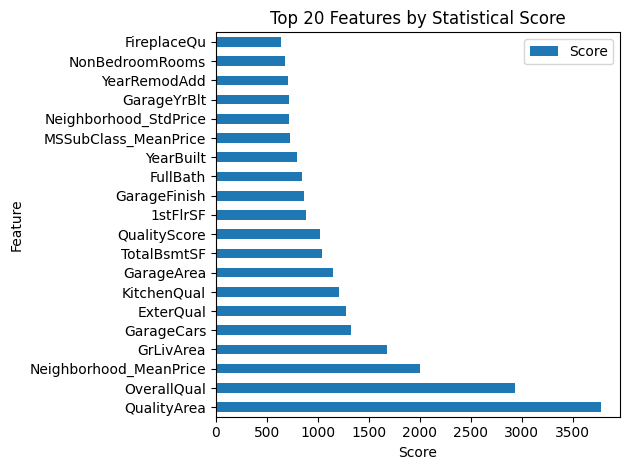

In [80]:
if y_transformed is not None:
    
    if is_classification:
        selector_stats = SelectKBest(score_func=chi2, k=min(50, X_corr_selected.shape[1]))
    else:
        selector_stats = SelectKBest(score_func=f_regression, k=min(50, X_corr_selected.shape[1]))
    
    X_stats = selector_stats.fit_transform(X_corr_selected, y_transformed)
    selected_features_stats = X_corr_selected.columns[selector_stats.get_support()].tolist()
    
    # Get feature scores
    feature_scores = pd.DataFrame({
        'Feature': X_corr_selected.columns,
        'Score': selector_stats.scores_
    }).sort_values('Score', ascending=False)
    
    print(f"Selected top {len(selected_features_stats)} features using statistical tests")
    print(f"\nTop 10 features by score:")
    print(feature_scores.head(10))
    
    # Visualize top features
    plt.figure(figsize=(12, 6))
    feature_scores.head(20).plot(x='Feature', y='Score', kind='barh')
    plt.title('Top 20 Features by Statistical Score')
    plt.xlabel('Score')
    plt.tight_layout()
    plt.show()

## Recursive Feature Elimination (Wrapper Method)

In [81]:
if y_transformed is not None:
    
    # Use a simple model for RFE
    if is_classification:
        estimator = RandomForestClassifier(n_estimators=50, random_state=42, n_jobs=-1)
    else:
        estimator = RandomForestRegressor(n_estimators=50, random_state=42, n_jobs=-1)
    
    rfe = RFE(estimator=estimator, n_features_to_select=30, step=5)
    X_rfe = rfe.fit_transform(X_corr_selected, y_transformed)
    selected_features_rfe = X_corr_selected.columns[rfe.get_support()].tolist()
    
    print(f"RFE selected {len(selected_features_rfe)} features")
    print(f"  Selected features: {selected_features_rfe[:10]}...")

RFE selected 30 features
  Selected features: ['MSZoning', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'BsmtQual', 'BsmtFinType1', 'BsmtFinSF1']...


## Feature Importance (Embedded Method)


Top 15 Important Features:
                   Feature  Importance
70             QualityArea    0.647528
74  Neighborhood_MeanPrice    0.075061
14             OverallQual    0.052795
32             TotalBsmtSF    0.031080
28              BsmtFinSF1    0.019173
37                1stFlrSF    0.008999
55              GarageCars    0.007916
76    MSSubClass_MeanPrice    0.007915
3                  LotArea    0.007842
17            YearRemodAdd    0.006964
16               YearBuilt    0.006783
1                 MSZoning    0.006060
56              GarageArea    0.006016
75   Neighborhood_StdPrice    0.006006
40               GrLivArea    0.005835


<Figure size 1200x800 with 0 Axes>

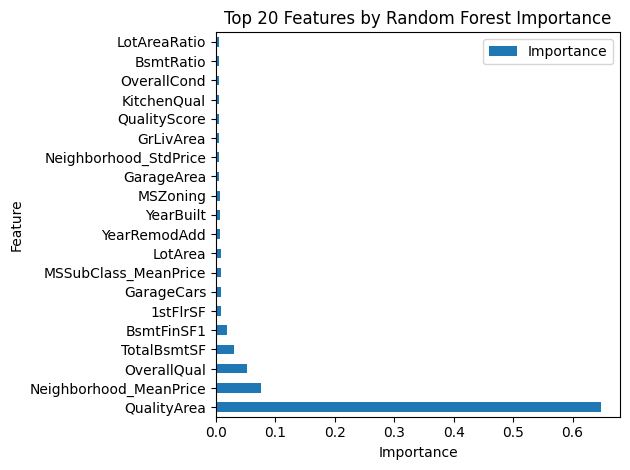

Selected top 40 features by importance


In [82]:
if y_transformed is not None:
    
    if is_classification:
        model_importance = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1)
    else:
        model_importance = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
    
    model_importance.fit(X_corr_selected, y_transformed)
    
    feature_importance = pd.DataFrame({
        'Feature': X_corr_selected.columns,
        'Importance': model_importance.feature_importances_
    }).sort_values('Importance', ascending=False)
    
    print(f"\nTop 15 Important Features:")
    print(feature_importance.head(15))
    
    # Visualize feature importance
    plt.figure(figsize=(12, 8))
    feature_importance.head(20).plot(x='Feature', y='Importance', kind='barh')
    plt.title('Top 20 Features by Random Forest Importance')
    plt.xlabel('Importance')
    plt.tight_layout()
    plt.show()
    
    # Select top features
    top_n_features = 40
    selected_features_importance = feature_importance.head(top_n_features)['Feature'].tolist()
    X_selected = X_corr_selected[selected_features_importance]
    print(f"Selected top {top_n_features} features by importance")

## L1 Regularization (Lasso) for feature selection

In [83]:
if y_transformed is not None and not is_classification:
    
    lasso = Lasso(alpha=0.01, random_state=42)
    lasso.fit(X_corr_selected, y_transformed)
    
    lasso_features = pd.DataFrame({
        'Feature': X_corr_selected.columns,
        'Coefficient': np.abs(lasso.coef_)
    }).sort_values('Coefficient', ascending=False)
    
    selected_features_lasso = lasso_features[lasso_features['Coefficient'] > 0]['Feature'].tolist()
    print(f"Lasso selected {len(selected_features_lasso)} non-zero features")
    print(f"\nTop 10 features by Lasso coefficient:")
    print(lasso_features.head(10))

Lasso selected 34 non-zero features

Top 10 features by Lasso coefficient:
                   Feature  Coefficient
40               GrLivArea     0.082780
77            QualityScore     0.063846
74  Neighborhood_MeanPrice     0.063274
70             QualityArea     0.049552
32             TotalBsmtSF     0.039884
16               YearBuilt     0.036058
3                  LotArea     0.025678
28              BsmtFinSF1     0.023922
55              GarageCars     0.020392
47             KitchenQual     0.019309


## Principal Component Analysis (PCA)

In [84]:
pca = PCA(n_components=0.95, random_state=42)  # Keep 95% variance
X_pca = pca.fit_transform(X_standard)

print(f"PCA reduced {X_standard.shape[1]} features to {X_pca.shape[1]} components")
print(f"  Explained variance: {pca.explained_variance_ratio_.sum():.3f}")

PCA reduced 151 features to 94 components
  Explained variance: 0.952


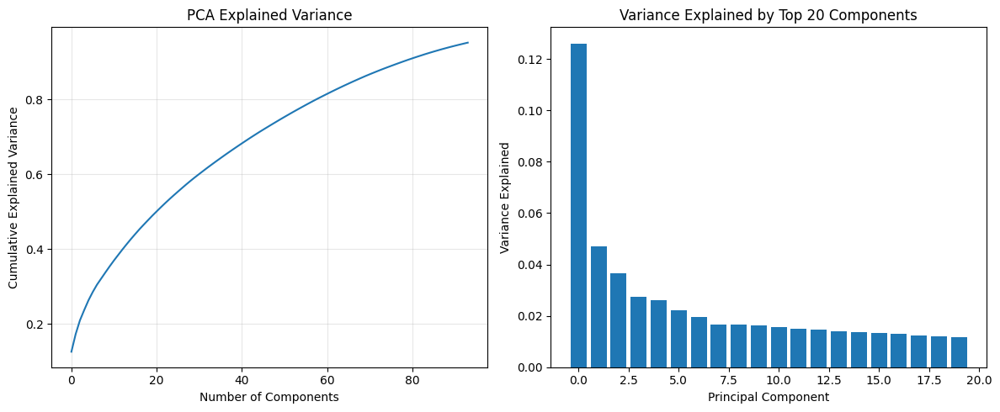

In [85]:
# Visualize explained variance
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('PCA Explained Variance')
plt.grid(True, alpha=0.3)

plt.subplot(1, 2, 2)
plt.bar(range(min(20, len(pca.explained_variance_ratio_))), 
        pca.explained_variance_ratio_[:20])
plt.xlabel('Principal Component')
plt.ylabel('Variance Explained')
plt.title('Variance Explained by Top 20 Components')
plt.tight_layout()
plt.show()

In [86]:
X_selected.shape[1] if 'X_selected' in locals() else X_corr_selected.shape[1]

40

# DATA SPLITTING


Train-Test Split (80-20)
Random split for regression
  Training set: (1168, 40)
  Test set: (292, 40)

Train-Validation Split
  Training set: (934, 40)
  Validation set: (234, 40)
  Test set: (292, 40)

Cross-Validation Setup
Created KFold with 5 splits


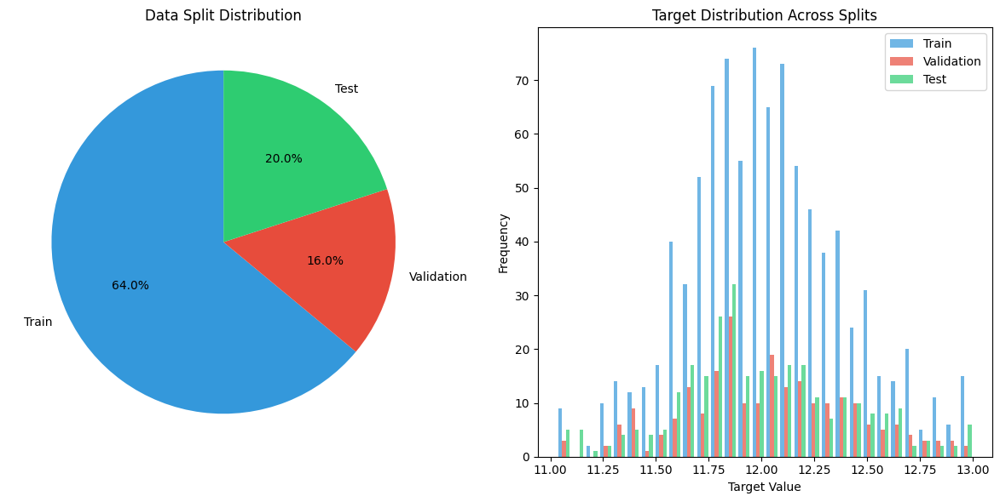

In [87]:
if y_transformed is not None:
    # Use the best selected features
    if 'X_selected' in locals():
        X_final = X_selected
    else:
        X_final = X_corr_selected
    
    # Train-Test Split
    print("\nTrain-Test Split (80-20)")
    
    if is_classification:
        X_train, X_test, y_train, y_test = train_test_split(
            X_final, y_transformed, test_size=0.2, random_state=42, stratify=y_transformed
        )
        print("Stratified split for classification")
    else:
        X_train, X_test, y_train, y_test = train_test_split(
            X_final, y_transformed, test_size=0.2, random_state=42
        )
        print("Random split for regression")
    
    print(f"  Training set: {X_train.shape}")
    print(f"  Test set: {X_test.shape}")
    
    # Train-Validation Split
    print("\nTrain-Validation Split")
    
    if is_classification:
        X_train_final, X_val, y_train_final, y_val = train_test_split(
            X_train, y_train, test_size=0.2, random_state=42, stratify=y_train
        )
    else:
        X_train_final, X_val, y_train_final, y_val = train_test_split(
            X_train, y_train, test_size=0.2, random_state=42
        )
    
    print(f"  Training set: {X_train_final.shape}")
    print(f"  Validation set: {X_val.shape}")
    print(f"  Test set: {X_test.shape}")
    
    # Cross-Validation Setup
    print("\nCross-Validation Setup")
    
    if is_classification:
        cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
        print("Created StratifiedKFold with 5 splits")
    else:
        cv = KFold(n_splits=5, shuffle=True, random_state=42)
        print("Created KFold with 5 splits")
    
    # Visualize data splits
    plt.figure(figsize=(12, 6))
    
    plt.subplot(1, 2, 1)
    sizes = [len(X_train_final), len(X_val), len(X_test)]
    labels = ['Train', 'Validation', 'Test']
    colors = ['#3498db', '#e74c3c', '#2ecc71']
    plt.pie(sizes, labels=labels, autopct='%1.1f%%', colors=colors, startangle=90)
    plt.title('Data Split Distribution')
    
    plt.subplot(1, 2, 2)
    if is_classification:
        train_dist = pd.Series(y_train_final).value_counts()
        val_dist = pd.Series(y_val).value_counts()
        test_dist = pd.Series(y_test).value_counts()
        
        x = np.arange(len(train_dist))
        width = 0.25
        
        plt.bar(x - width, train_dist.values, width, label='Train', color='#3498db')
        plt.bar(x, val_dist.values, width, label='Validation', color='#e74c3c')
        plt.bar(x + width, test_dist.values, width, label='Test', color='#2ecc71')
        
        plt.xlabel('Class')
        plt.ylabel('Count')
        plt.title('Class Distribution Across Splits')
        plt.legend()
    else:
        plt.hist([y_train_final, y_val, y_test], label=['Train', 'Validation', 'Test'],
                bins=30, alpha=0.7, color=colors)
        plt.xlabel('Target Value')
        plt.ylabel('Frequency')
        plt.title('Target Distribution Across Splits')
        plt.legend()
    
    plt.tight_layout()
    plt.show()
    
else:
    print("No target variable - skipping data splitting")

In [89]:
print("\nFeature Versions:")
print(f"X_standard:  StandardScaler scaled ({X_standard.shape[1]} features)")
print(f"X_minmax:    MinMaxScaler scaled ({X_minmax.shape[1]} features)")
print(f"X_robust:    RobustScaler scaled ({X_robust.shape[1]} features)")
print(f"X_unscaled:  No scaling for tree models ({X_unscaled.shape[1]} features)")
if 'X_pca' in locals():
    print(f"X_pca:       PCA transformed ({X_pca.shape[1]} components)")
if 'X_selected' in locals():
    print(f"X_selected:  Feature selected ({X_selected.shape[1]} features)")

if y_transformed is not None:
    print(f"\nSplit Datasets:")
    print(f"X_train_final, y_train_final: {X_train_final.shape}")
    print(f"X_val, y_val:                 {X_val.shape}")
    print(f"X_test, y_test:               {X_test.shape}")


Feature Versions:
X_standard:  StandardScaler scaled (151 features)
X_minmax:    MinMaxScaler scaled (151 features)
X_robust:    RobustScaler scaled (151 features)
X_unscaled:  No scaling for tree models (151 features)
X_pca:       PCA transformed (94 components)
X_selected:  Feature selected (40 features)

Split Datasets:
X_train_final, y_train_final: (934, 40)
X_val, y_val:                 (234, 40)
X_test, y_test:               (292, 40)
